# CIS 9655 Fall 2021 - Python Project 

# COVID Watch NYC

### Aarif Jahan, Apurva Sharma, Janerisa Encarnacion, Juna Iafelice

----------------------------------------------------------------------

## Necessary Python Packages

In [1]:
# Get necessary packages

import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.ticker as tick
import seaborn as sns
import pandas_bokeh
import datetime
import datetime as dt
import panel as pn
import json
import holoviews
import ipywidgets
import hvplot
import geopandas as gpd
import plotly.express as px
from pandas.plotting import scatter_matrix

# Set ggplot as the matplotlib style for this notebook
plt.style.use('ggplot')

# To display the output of plotting commands inline within frontends like the Jupyter notebook
%matplotlib inline

# To suppress the scientific notable through the entire jupyter notebook. 
# This notation format will now display any numeric values upto 5 decimal points
pd.set_option('display.float_format', lambda x: '%.5f' % x) 

# Loading bokeh inline
from bokeh.resources import INLINE
import bokeh.io
bokeh.io.output_notebook(INLINE) 

from bokeh.io import curdoc
from bokeh.layouts import gridplot
from bokeh.plotting import figure, show, output_notebook
from bokeh.tile_providers import CARTODBPOSITRON, get_provider
from bokeh.models import HoverTool, ColumnDataSource, DataRange1d, Range1d, GeoJSONDataSource, LinearColorMapper, ColorBar, HoverTool, FuncTickFormatter, NumeralTickFormatter, DatetimeTickFormatter
from bokeh.palettes import brewer
from bokeh.transform import factor_cmap, factor_mark

# Ignore warnings for easier readibility
import warnings
warnings.filterwarnings('ignore')
output_notebook()
 
# Import panel library
import panel as pn
from panel import widgets

pn.extension('plotly')
pn.extension()


Loading BokehJS ...

Loading BokehJS ...

In [2]:
# Function to change large tick values to billions B, millions M and thousands K

def reformat_large_tick_values(tick_val, pos):
    if tick_val >= 1000000000:
        val = round(tick_val/1000000000, 1)
        new_tick_format = '{:}b'.format(val)
    elif tick_val >= 1000000:
        val = round(tick_val/1000000, 1)
        new_tick_format = '{:}m'.format(val)
    elif tick_val >= 1000:
        val = round(tick_val/1000, 1)
        new_tick_format = '{:}k'.format(val)
    elif tick_val < 1000:
        new_tick_format = round(tick_val, 1)
    else:
        new_tick_format = tick_val

    # make new_tick_format into a string value
    new_tick_format = str(new_tick_format)
    
    # code below will keep 4.5M as is but change values such as 4.0M to 4M since that zero after the decimal isn't needed
    index_of_decimal = new_tick_format.find(".")
    
    if index_of_decimal != -1:
        value_after_decimal = new_tick_format[index_of_decimal+1]
        if value_after_decimal == "0":
            # remove the 0 after the decimal point since it's not needed
            new_tick_format = new_tick_format[0:index_of_decimal] + new_tick_format[index_of_decimal+2:]
            
    return new_tick_format



In [3]:
# Define population number for each of the five boroughs in NYC to be used for per capita measures
bx_pop = 1472654
bk_pop = 2736074
mn_pop = 1694251
qn_pop = 2405464
si_pop = 495747

## Chart Series 1 - Bokeh Line Plot - COVID-19 Evolution in NYC

In [4]:
# Read data from the excel file and store in a pandas dataframe
df0 = pd.read_csv("data-by-day.csv")

In [5]:
# Explore data
df0.head()

,date_of_interest,CASE_COUNT,PROBABLE_CASE_COUNT,HOSPITALIZED_COUNT,DEATH_COUNT,PROBABLE_DEATH_COUNT,CASE_COUNT_7DAY_AVG,ALL_CASE_COUNT_7DAY_AVG,HOSP_COUNT_7DAY_AVG,DEATH_COUNT_7DAY_AVG,...,SI_DEATH_COUNT,SI_PROBABLE_DEATH_COUNT,SI_CASE_COUNT_7DAY_AVG,SI_PROBABLE_CASE_COUNT_7DAY_AVG,SI_ALL_CASE_COUNT_7DAY_AVG,SI_HOSPITALIZED_COUNT_7DAY_AVG,SI_DEATH_COUNT_7DAY_AVG,SI_ALL_DEATH_COUNT_7DAY_AVG,INCOMPLETE,TOTAL_TEST
0,02/29/20,1,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,03/01/20,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,03/02/20,0,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,03/03/20,1,0,7,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,15
4,03/04/20,5,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,40


In [6]:
# Rename columns as needed 
trend_df = df0.rename(columns={"date_of_interest":"date","DEATH_COUNT": "Deaths", "CASE_COUNT": "Cases",
                        "HOSPITALIZED_COUNT": "Hospitalizations", "TOTAL_TEST": "Tests"})

# Change date from string to datetime field
trend_df['date'] = pd.to_datetime(trend_df['date'], format="%m/%d/%y")

# Calculate rolling averages for 7-day tests data
trend_df['TEST_COUNT_7DAY_AVG'] = trend_df.Tests.rolling(7).mean()
trend_df['TEST_COUNT_7DAY_AVG'] = trend_df['TEST_COUNT_7DAY_AVG'].fillna(0)
trend_df['TEST_COUNT_7DAY_AVG'] = trend_df['TEST_COUNT_7DAY_AVG'].astype(int)

trend_df.head()

,date,Cases,PROBABLE_CASE_COUNT,Hospitalizations,Deaths,PROBABLE_DEATH_COUNT,CASE_COUNT_7DAY_AVG,ALL_CASE_COUNT_7DAY_AVG,HOSP_COUNT_7DAY_AVG,DEATH_COUNT_7DAY_AVG,...,SI_PROBABLE_DEATH_COUNT,SI_CASE_COUNT_7DAY_AVG,SI_PROBABLE_CASE_COUNT_7DAY_AVG,SI_ALL_CASE_COUNT_7DAY_AVG,SI_HOSPITALIZED_COUNT_7DAY_AVG,SI_DEATH_COUNT_7DAY_AVG,SI_ALL_DEATH_COUNT_7DAY_AVG,INCOMPLETE,Tests,TEST_COUNT_7DAY_AVG
0,2020-02-29,1,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2020-03-01,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2020-03-02,0,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,2020-03-03,1,0,7,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,15,0
4,2020-03-04,5,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,40,0


In [7]:
# Convert to bokeh column data source for rendering with bokeh functions
trend_dfCDS = ColumnDataSource(trend_df)

In [8]:
# Add widget for the Radio button group to allow for metric selection 
uS = pn.widgets.RadioButtonGroup(name="Select Factor", value = 'Cases', options= ['Cases','Hospitalizations','Deaths', 'Tests'])
uS

RadioButtonGroup(name='Select Factor', options=['Cases', 'Hospitalization...], value='Cases')

In [9]:
 # React feature to run this function everytime uS widget is modified
@pn.depends(uS)
def react_pbk_line_covid(uSVar):
    
    # Define variable for storing dynamic 7-day avg variable
    seven_avg = ""
    
    # Apply bokeh built-in theme and 7-day variable based on widget selection
    if uSVar == 'Deaths':
        curdoc().theme = 'dark_minimal'
        seven_avg = "DEATH_COUNT_7DAY_AVG" 
    elif uSVar == 'Tests':
        curdoc().theme = 'light_minimal'
        seven_avg = "TEST_COUNT_7DAY_AVG"
    elif uSVar == 'Cases':
        curdoc().theme = 'light_minimal'
        seven_avg = "CASE_COUNT_7DAY_AVG"
    elif uSVar == 'Hospitalizations':
        curdoc().theme = 'light_minimal'
        seven_avg = "HOSP_COUNT_7DAY_AVG"
    
    # Configure hover tool parameters and labels
    hover_tool = HoverTool(tooltips=[( 'Date', '@date{%F}'), (uSVar, '@' + uSVar)],
                           formatters={'@date'  : 'datetime'})
    
    # Define tools used for task abstraction
    TOOLS = [hover_tool,'box_zoom', 'wheel_zoom', 'reset', 'save']
    
    # Create figure element with all related info
    p = figure(tools = TOOLS, title=f"Tracking COVID-19 {uSVar}", x_axis_label='Date', y_axis_label=uSVar, 
               plot_width=800, plot_height=500, x_range=DataRange1d(bounds="auto"))
    
    # Add two lines, one for total daily count based on dynamic widget and one for its corresponding 7-day avg line
    p.line('date', uSVar, source=trend_dfCDS, legend_label = "Daily Number")
    p.line('date', seven_avg, source=trend_dfCDS, line_color = 'red', legend_label = "7-Day Avg")
    
    # Format axis labels
    p.xaxis.axis_label_text_font_style = "bold"
    p.yaxis.axis_label_text_font_style = "bold"
    
    # Transform axes ticks to correct format
    p.xaxis.formatter=DatetimeTickFormatter(days="%d-%b", months="%b-%y")
    p.yaxis.formatter = NumeralTickFormatter(format = '0a')
    
    # Apply dynamic background color fill based on selection - this allows mimetic correspondence for deaths while keeping consistent background for the rest
    if uSVar == 'Deaths':
        pass
    elif uSVar == 'Tests' or uSVar == 'Cases' or uSVar == 'Hospitalizations':
        p.background_fill_color = "gainsboro"
        p.legend.background_fill_color = "gainsboro"

    # Adjust legend location as needed
    if uSVar == "Tests":
        p.legend.location = "top_left"
    elif uSVar == 'Deaths' or uSVar == 'Cases' or uSVar == 'Hospitalizations':
        p.legend.location = "top_right"
  
    # Return final figure
    return p

In [10]:
# Preview widget and plot together
pn.Column(uS, react_pbk_line_covid)

Column
    [0] RadioButtonGroup(name='Select Factor', options=['Cases', 'Hospitalization...], value='Cases')
    [1] ParamFunction(function)

## Chart Series 2 - Matplotlib Bar Plots - Infections Distribution

In [11]:
# Read second data table from the excel file and store in a pandas dataframe
df1 = pd.read_csv("by-group.csv")

In [12]:
# Explore data
df1.head(5)

,group,subgroup,CONFIRMED_CASE_RATE,CASE_RATE,HOSPITALIZED_RATE,DEATH_RATE,CONFIRMED_CASE_COUNT,PROBABLE_CASE_COUNT,CASE_COUNT,HOSPITALIZED_COUNT,DEATH_COUNT
0,Age group,0-4,4344.51000,5921.89000,179.29000,nan,22753.00000,8261.00000,31014.00000,939.00000,nan
1,Age group,5-12,6711.31000,8987.39000,73.97000,nan,50171.00000,17015.00000,67186.00000,553.00000,nan
2,Age group,13-17,8336.92000,11070.69000,148.78000,nan,36086.00000,11833.00000,47919.00000,644.00000,nan
3,Age group,0-17,nan,nan,nan,1.70000,nan,nan,nan,nan,29.00000
4,Age group,18-24,12377.84000,15867.83000,412.82000,8.09000,87223.00000,24593.00000,111816.00000,2909.00000,57.00000


In [13]:
# List all columns
df1.columns

Index(['group', 'subgroup', 'CONFIRMED_CASE_RATE', 'CASE_RATE',
       'HOSPITALIZED_RATE', 'DEATH_RATE', 'CONFIRMED_CASE_COUNT',
       'PROBABLE_CASE_COUNT', 'CASE_COUNT', 'HOSPITALIZED_COUNT',
       'DEATH_COUNT'],
      dtype='object')

In [14]:
# Get rid of last row
df1 = df1.iloc[:-1,:]

In [15]:
# Add widget for the Radio button group to allow for metric selection 
uField = pn.widgets.RadioButtonGroup(name="Select Factor", value = 'Race', options= list(set(df1.group)))
uField

RadioButtonGroup(name='Select Factor', options=['Poverty', 'Race', ...], value='Race')

In [16]:
@pn.depends(uField)
def react_mpl_plot_bar(uFieldVar):
    
    # Create the figure container and subplot
    
    rFig = plt.Figure(figsize=(9,9),tight_layout = True)
    rPlot = rFig.add_subplot(311)
    rPlot1 = rFig.add_subplot(312)
    rPlot2 = rFig.add_subplot(313)
    
    
    #  Filter out only the columns selected by the the widget variable
    
    dataframe = df1[["group","subgroup","CASE_COUNT","HOSPITALIZED_COUNT","DEATH_COUNT"]]
    dataframe = dataframe[dataframe["group"] == str(uFieldVar)]    
    dataframe1 = dataframe
    
    # Add index to keep order for ordinal variable - will be removed later for better axis labels
    dataframe1['index1'] = dataframe1.index
    
    # Define dataframes for cases, hospitalizations and deaths and calculate percentages
    dframe_case = dataframe1.groupby(['index1','subgroup'])['CASE_COUNT'].sum()
    dframe_case = dframe_case.droplevel('index1')
    dframe_case_sum = dframe_case.div(dframe_case.sum(axis=0), axis=0)*100
 
    dframe_hosp = dataframe1.groupby(['index1','subgroup'])['HOSPITALIZED_COUNT'].sum()
    dframe_hosp = dframe_hosp.droplevel('index1')
    dframe_hosp_sum = dframe_hosp.div(dframe_hosp.sum(axis=0), axis=0)*100
    
    dframe_death = dataframe1.groupby(['index1','subgroup'])['DEATH_COUNT'].sum()
    dframe_death = dframe_death.droplevel('index1')
    dframe_death_sum = dframe_death.div(dframe_death.sum(axis=0), axis=0)*100
    
    # Draw the required bar chart
    ax = dframe_case.plot(ax = rPlot, kind = 'bar', rot=0, legend = False, xlabel = "")
    ax1 = dframe_hosp.plot(ax = rPlot1, kind = 'bar', rot=0, legend = False, xlabel = "")
    ax2 = dframe_death.plot(ax = rPlot2, kind = 'bar', rot=0, legend = False)

    # Add axis labels 
    x_label = list(set(dataframe.group))[0]
    
    # Add chart title
    ax.set_title(f"COVID Statistics by {x_label}", fontweight = 'bold')
    
    # Add x label only for the last chart
    ax2.set_xlabel(f"{x_label}", fontweight = 'bold')
    
    # Add ya labels for all charts
    ax.set_ylabel('Cases', fontweight = 'bold')
    ax1.set_ylabel('Hospitalizations', fontweight = 'bold')
    ax2.set_ylabel('Deaths', fontweight = 'bold')

    # Loop over all plot axes, adjust grid lines for better visibility, format label ticker for better readability
    axis_lst = [ax, ax1, ax2]
    
    for axis in axis_lst:
        axis.grid(linestyle='-', linewidth=0.35, axis = 'y')
        axis.grid(b=None, axis = 'x')
        axis.yaxis.set_major_formatter(tick.FuncFormatter(reformat_large_tick_values))
    
    # Loop over each bar in all three plots
    for axis in axis_lst:
        
        rects = axis.patches
        
        bar_heights = []
        
    

        # Loop over each bar, annotate with percentage distribution
        for num, rect in enumerate(rects):

            # Get X and Y placement of label from rect
            x_height = rect.get_height()
            x_width = rect.get_width()
            x_loc = rect.get_x()


            # Number of points between bar and label
            space = 0
            # Vertical alignment for annotations
            ha = 'center'

            if axis == ax:
                label = '{:,.0f}%'.format(dframe_case_sum[num])
            elif axis == ax1:
                label = '{:,.0f}%'.format(dframe_hosp_sum[num])
            elif axis == ax2:
                label = '{:,.0f}%'.format(dframe_death_sum[num])
                
            if int(label.strip('%')) > 1:
            
                axis.annotate(
                    label,                      
                    (x_loc + (x_width/2), x_height*0.85),  
                    xytext=(space, 0),          
                    textcoords='offset points', 
                    va='center',                
                    ha=ha,                      
                    color = 'white',
                    fontweight = 'bold'

                )           

            # Get X and Y placement of label from rect
            x_value = int(rect.get_height())
            bar_heights.append(x_value)

        # Update maximum bar color as red
        max_value = int(max(bar_heights))
        
        for rect in rects:

            x_match = int(rect.get_height())
            if x_match == max_value:
                rect.set_color('tab:red')
            else:
                rect.set_color('tab:blue')

            
    # return the figure on function call
    return rFig 

Column
    [0] RadioButtonGroup(name='Select Factor', options=['Poverty', 'Race', ...], value='Race')
    [1] ParamFunction(function)
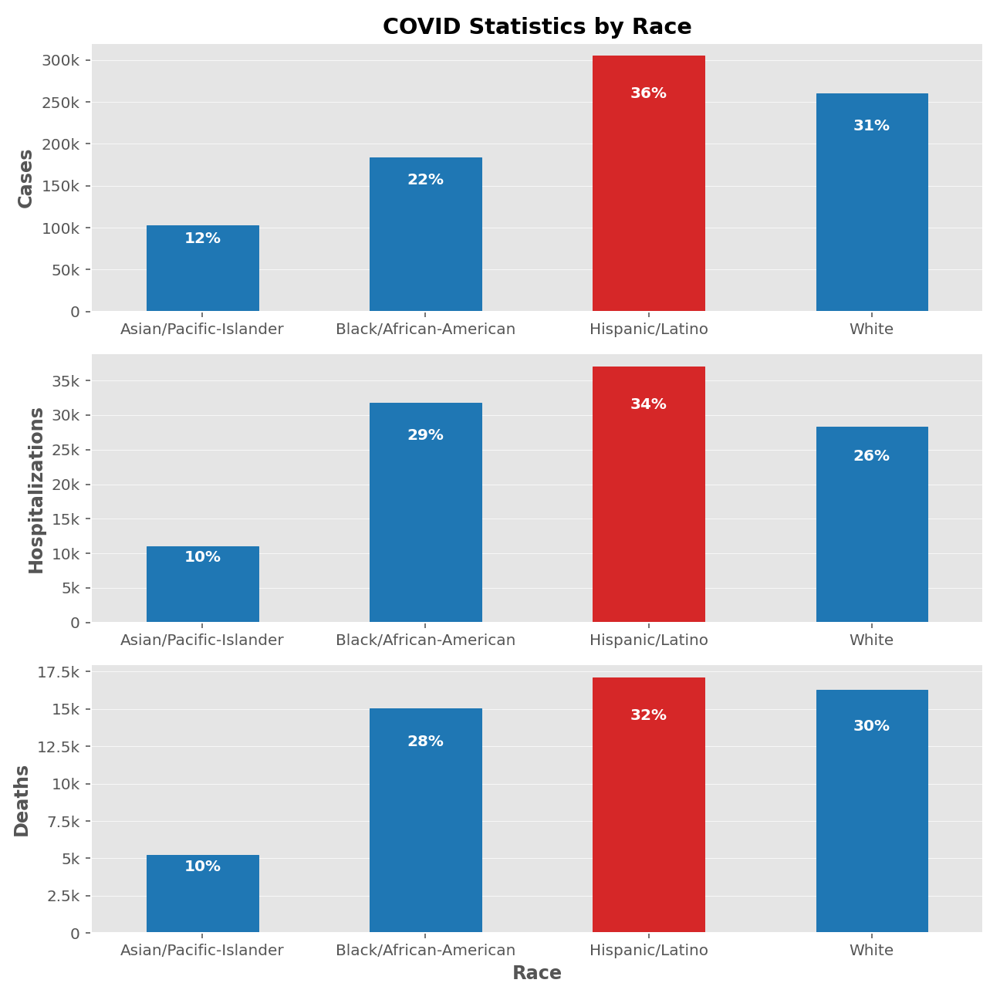

In [17]:
# Preview widget and plot together
pn.Column(uField, react_mpl_plot_bar)

## Chart Series 3 - Seaborn Heatmaps - Deaths Analysis

In [18]:
# Read data table from the excel file and store in a pandas dataframe
df2 = pd.read_csv("deaths-by-race-age.csv")

In [19]:
# Explore data
df2.head()

,RACE_GROUP,AGE_0_17_YRS,AGE_18_24_YRS,AGE_25_34_YRS,AGE_35_44_YRS,AGE_45_54_YRS,AGE_55_64_YRS,AGE_65_74_YRS,AGE_GE_75_YRS
0,Asian,1.39000,4.06000,9.60000,26.41000,98.53000,297.94000,735.84000,2276.12000
1,Black,2.68000,11.24000,33.16000,94.06000,265.06000,664.81000,1499.45000,3357.44000
2,Hispanic,1.33000,9.73000,30.91000,125.09000,303.21000,658.39000,1472.28000,3596.57000
3,White,1.54000,2.60000,8.70000,19.66000,78.33000,283.95000,671.50000,2602.76000


In [20]:
# Update index of dataframe
df2 = df2.set_index('RACE_GROUP')

In [21]:
# Rename columns for better readability
df2 = df2.rename(columns={"AGE_0_17_YRS":  "0-17" , "AGE_18_24_YRS": "18-24",
                          "AGE_25_34_YRS": "25-34", "AGE_35_44_YRS": "35-44",
                          "AGE_45_54_YRS": "45-54", "AGE_55_64_YRS": "55-64",
                          "AGE_65_74_YRS": "65-74", "AGE_GE_75_YRS": "Over 75"
                         })

df2

,0-17,18-24,25-34,35-44,45-54,55-64,65-74,Over 75
RACE_GROUP,,,,,,,,
Asian,1.39000,4.06000,9.60000,26.41000,98.53000,297.94000,735.84000,2276.12000
Black,2.68000,11.24000,33.16000,94.06000,265.06000,664.81000,1499.45000,3357.44000
Hispanic,1.33000,9.73000,30.91000,125.09000,303.21000,658.39000,1472.28000,3596.57000
White,1.54000,2.60000,8.70000,19.66000,78.33000,283.95000,671.50000,2602.76000


In [22]:
# Add widget for check button that allows for multiple income level selection
uAge = pn.widgets.CheckButtonGroup(
    name='Select Age Group', value = list(df2.columns[:]), options=list(df2.columns[:]),
    inline=False)

uAge

CheckButtonGroup(name='Select Age Group', options=['0-17', '18-24', ...], value=['0-17', '18-24', ...])

In [23]:
# Define reactive function for Race based deaths heatmap
@pn.depends(uAge)
def sns_plot_heatmap_race_age(uAgeVar):
    
    # Filter based on widget selection
    dframe = df2[list(uAgeVar)]
    
    # Create the figure container and subplot - use tight_layout to ensure auto resizing with changing regions
    rFig = plt.Figure(figsize=(10, 4))
    rPlot = rFig.add_subplot()
    
    # Create a seaborn heatmap plot with yellow-green-blue color scare and formatted colorbar
    ax1 = sns.heatmap(dframe, ax = rPlot, cmap='rocket_r', cbar_kws={'label': '', 'format': tick.FuncFormatter(reformat_large_tick_values)})
                      
            
    
    # Set chart title, axes labels and orientation
    ax1.set_title("COVID Death Rate By Race and Age Group", fontweight = 'bold', color = 'dimgray')
    ax1.set_xticklabels(ax1.get_xticklabels(), rotation=0)
    ax1.set_yticklabels(ax1.get_yticklabels(), rotation=0)
    ax1.set_xlabel('Age Goup',fontweight = "bold")
    ax1.set_ylabel('Race', fontweight = "bold")
    
    # Return final figure                   
    return rFig


Column
    [0] CheckButtonGroup(name='Select Age Group', options=['0-17', '18-24', ...], value=['0-17', '18-24', ...])
    [1] ParamFunction(function)
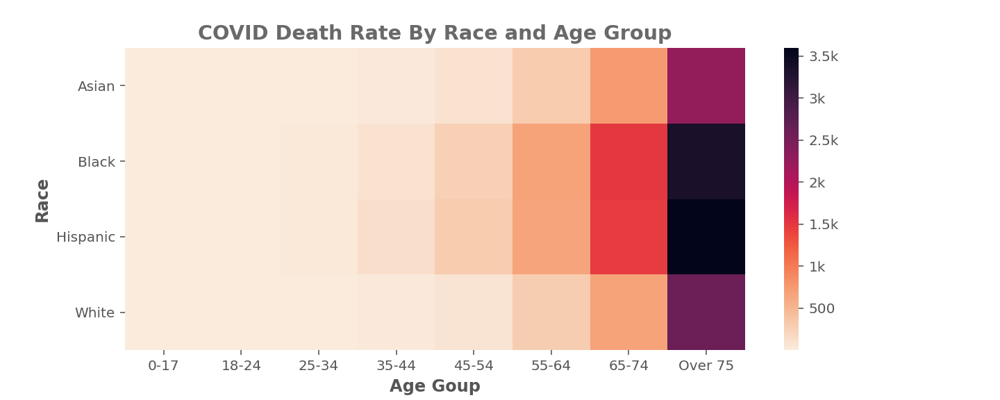

In [24]:
# Preview plot with widget
pn.Column(uAge, sns_plot_heatmap_race_age)

In [25]:
# Read data from the excel file and store in a pandas dataframe
df3 = pd.read_csv("deaths-by-boro-age.csv")

In [26]:
# Explore data
df3.head()

,BOROUGH_GROUP,AGE_0_17_YRS,AGE_18_24_YRS,AGE_25_34_YRS,AGE_35_44_YRS,AGE_45_54_YRS,AGE_55_64_YRS,AGE_65_74_YRS,AGE_GE_75_YRS
0,Bronx,1.44000,8.61000,31.66000,108.14000,286.59000,722.31000,1575.89000,3647.26000
1,Brooklyn,2.09000,10.10000,20.85000,62.29000,224.47000,547.71000,1252.84000,3464.83000
2,Manhattan,0.86000,3.43000,10.22000,35.45000,104.30000,278.71000,642.28000,2200.14000
3,Queens,1.79000,6.39000,24.74000,90.14000,218.25000,568.11000,1183.38000,3055.08000
4,StatenIsland,1.94000,17.64000,21.63000,67.60000,171.41000,337.21000,945.16000,3244.29000


In [27]:
# Update table index
df3 = df3.set_index('BOROUGH_GROUP')

In [28]:
# Rename columns as needed
df3 = df3.rename(columns={"AGE_0_17_YRS":  "0-17" , "AGE_18_24_YRS": "18-24",
                          "AGE_25_34_YRS": "25-34", "AGE_35_44_YRS": "35-44",
                          "AGE_45_54_YRS": "45-54", "AGE_55_64_YRS": "55-64",
                          "AGE_65_74_YRS": "65-74", "AGE_GE_75_YRS": "Over 75"
                         })

df3

,0-17,18-24,25-34,35-44,45-54,55-64,65-74,Over 75
BOROUGH_GROUP,,,,,,,,
Bronx,1.44000,8.61000,31.66000,108.14000,286.59000,722.31000,1575.89000,3647.26000
Brooklyn,2.09000,10.10000,20.85000,62.29000,224.47000,547.71000,1252.84000,3464.83000
Manhattan,0.86000,3.43000,10.22000,35.45000,104.30000,278.71000,642.28000,2200.14000
Queens,1.79000,6.39000,24.74000,90.14000,218.25000,568.11000,1183.38000,3055.08000
StatenIsland,1.94000,17.64000,21.63000,67.60000,171.41000,337.21000,945.16000,3244.29000


In [29]:
# Define reactive function for Borough based deaths heatmap
@pn.depends(uAge)
def sns_plot_heatmap_boro_age(uAgeVar):
    
    # Filter based on widget selection
    dframe = df3[list(uAgeVar)]
    
    
    # Create the figure container and subplot - use tight_layout to ensure auto resizing with changing regions
    rFig = plt.Figure(figsize=(10, 4))
    rPlot = rFig.add_subplot()
    
    # Create a seaborn heatmap plot with yellow-green-blue color scare and formatted colorbar
    ax1 = sns.heatmap(dframe, ax = rPlot, cmap='rocket_r', cbar_kws={'label': '', 'format': tick.FuncFormatter(reformat_large_tick_values)})
                    
    
    # Set chart title, axes labels and orientation
    ax1.set_title("COVID Death Rate By Borough and Age Group", fontweight = 'bold', color = 'dimgray')
    ax1.set_xticklabels(ax1.get_xticklabels(), rotation=0)
    ax1.set_yticklabels(ax1.get_yticklabels(), rotation=0)
    ax1.set_xlabel('Age Goup', fontweight = "bold")
    ax1.set_ylabel('Borough', fontweight = "bold")
    
    # Return final figure                   
    return rFig


Column
    [0] CheckButtonGroup(name='Select Age Group', options=['0-17', '18-24', ...], value=['0-17', '18-24', ...])
    [1] ParamFunction(function)
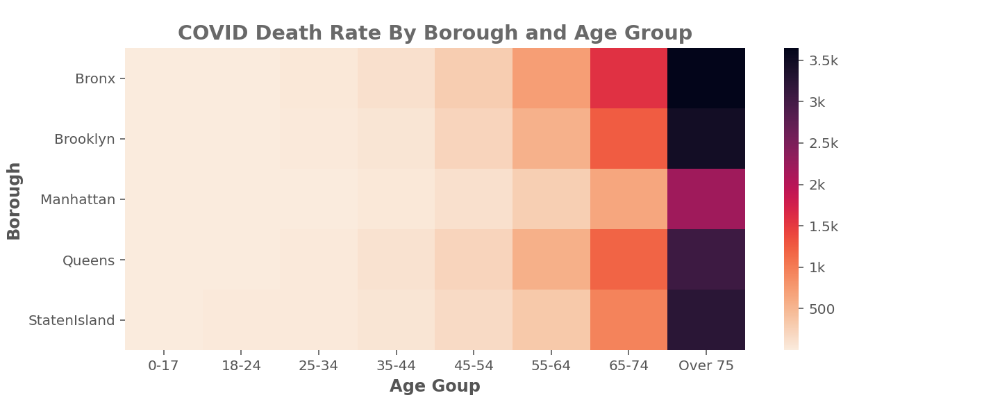

In [30]:
# Preview plot with widget
pn.Column(uAge, sns_plot_heatmap_boro_age)

## Chart Series 4 - Matplotlib Line Charts - Trends in Boroughs

In [31]:
# Read data from the excel file and store in a pandas dataframe
df4 = pd.read_csv("data-by-day.csv")

In [32]:
# Explore data
df4.head()

,date_of_interest,CASE_COUNT,PROBABLE_CASE_COUNT,HOSPITALIZED_COUNT,DEATH_COUNT,PROBABLE_DEATH_COUNT,CASE_COUNT_7DAY_AVG,ALL_CASE_COUNT_7DAY_AVG,HOSP_COUNT_7DAY_AVG,DEATH_COUNT_7DAY_AVG,...,SI_DEATH_COUNT,SI_PROBABLE_DEATH_COUNT,SI_CASE_COUNT_7DAY_AVG,SI_PROBABLE_CASE_COUNT_7DAY_AVG,SI_ALL_CASE_COUNT_7DAY_AVG,SI_HOSPITALIZED_COUNT_7DAY_AVG,SI_DEATH_COUNT_7DAY_AVG,SI_ALL_DEATH_COUNT_7DAY_AVG,INCOMPLETE,TOTAL_TEST
0,02/29/20,1,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,03/01/20,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,03/02/20,0,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,03/03/20,1,0,7,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,15
4,03/04/20,5,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,40


In [33]:
# List all column names
df4.columns

Index(['date_of_interest', 'CASE_COUNT', 'PROBABLE_CASE_COUNT',
       'HOSPITALIZED_COUNT', 'DEATH_COUNT', 'PROBABLE_DEATH_COUNT',
       'CASE_COUNT_7DAY_AVG', 'ALL_CASE_COUNT_7DAY_AVG', 'HOSP_COUNT_7DAY_AVG',
       'DEATH_COUNT_7DAY_AVG', 'ALL_DEATH_COUNT_7DAY_AVG', 'BX_CASE_COUNT',
       'BX_PROBABLE_CASE_COUNT', 'BX_HOSPITALIZED_COUNT', 'BX_DEATH_COUNT',
       'BX_PROBABLE_DEATH_COUNT', 'BX_CASE_COUNT_7DAY_AVG',
       'BX_PROBABLE_CASE_COUNT_7DAY_AVG', 'BX_ALL_CASE_COUNT_7DAY_AVG',
       'BX_HOSPITALIZED_COUNT_7DAY_AVG', 'BX_DEATH_COUNT_7DAY_AVG',
       'BX_ALL_DEATH_COUNT_7DAY_AVG', 'BK_CASE_COUNT',
       'BK_PROBABLE_CASE_COUNT', 'BK_HOSPITALIZED_COUNT', 'BK_DEATH_COUNT',
       'BK_PROBABLE_DEATH_COUNT', 'BK_CASE_COUNT_7DAY_AVG',
       'BK_PROBABLE_CASE_COUNT_7DAY_AVG', 'BK_ALL_CASE_COUNT_7DAY_AVG',
       'BK_HOSPITALIZED_COUNT_7DAY_AVG', 'BK_DEATH_COUNT_7DAY_AVG',
       'BK_ALL_DEATH_COUNT_7DAY_AVG', 'MN_CASE_COUNT',
       'MN_PROBABLE_CASE_COUNT', 'MN_HOSPITALIZED_

In [34]:
# Rename columns as needed
df4 = df4[['date_of_interest',
           'BX_CASE_COUNT','BX_HOSPITALIZED_COUNT', 'BX_DEATH_COUNT',
           'BK_CASE_COUNT','BK_HOSPITALIZED_COUNT', 'BK_DEATH_COUNT',
           'MN_CASE_COUNT','MN_HOSPITALIZED_COUNT', 'MN_DEATH_COUNT',
           'QN_CASE_COUNT','QN_HOSPITALIZED_COUNT', 'QN_DEATH_COUNT',
           'SI_CASE_COUNT','SI_HOSPITALIZED_COUNT', 'SI_DEATH_COUNT',
          ]]

df4

,date_of_interest,BX_CASE_COUNT,BX_HOSPITALIZED_COUNT,BX_DEATH_COUNT,BK_CASE_COUNT,BK_HOSPITALIZED_COUNT,BK_DEATH_COUNT,MN_CASE_COUNT,MN_HOSPITALIZED_COUNT,MN_DEATH_COUNT,QN_CASE_COUNT,QN_HOSPITALIZED_COUNT,QN_DEATH_COUNT,SI_CASE_COUNT,SI_HOSPITALIZED_COUNT,SI_DEATH_COUNT
0,02/29/20,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0
1,03/01/20,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
2,03/02/20,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0
3,03/03/20,0,1,0,0,3,0,0,1,0,1,2,0,0,0,0
4,03/04/20,0,0,0,1,1,0,2,1,0,2,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
580,10/01/21,129,17,1,389,23,2,198,7,0,227,14,1,75,2,0
581,10/02/21,67,17,2,258,9,1,110,5,0,135,13,4,46,3,0
582,10/03/21,48,7,3,423,15,4,79,3,1,195,4,1,69,1,0
583,10/04/21,144,2,4,453,5,3,178,1,0,241,3,1,79,0,0


In [35]:
# Rename columns as needed
df4 = df4.rename(columns={"date_of_interest":  "Date" , 
                          "BX_CASE_COUNT": "BX_C", "BX_HOSPITALIZED_COUNT": "BX_H", "BX_DEATH_COUNT": "BX_D",
                          "BK_CASE_COUNT": "BK_C", "BK_HOSPITALIZED_COUNT": "BK_H", "BK_DEATH_COUNT": "BK_D",
                          "MN_CASE_COUNT": "MN_C", "MN_HOSPITALIZED_COUNT": "MN_H", "MN_DEATH_COUNT": "MN_D",
                          "QN_CASE_COUNT": "QN_C", "QN_HOSPITALIZED_COUNT": "QN_H", "QN_DEATH_COUNT": "QN_D",
                          "SI_CASE_COUNT": "SI_C", "SI_HOSPITALIZED_COUNT": "SI_H", "SI_DEATH_COUNT": "SI_D"    
                         })

df4

,Date,BX_C,BX_H,BX_D,BK_C,BK_H,BK_D,MN_C,MN_H,MN_D,QN_C,QN_H,QN_D,SI_C,SI_H,SI_D
0,02/29/20,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0
1,03/01/20,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
2,03/02/20,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0
3,03/03/20,0,1,0,0,3,0,0,1,0,1,2,0,0,0,0
4,03/04/20,0,0,0,1,1,0,2,1,0,2,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
580,10/01/21,129,17,1,389,23,2,198,7,0,227,14,1,75,2,0
581,10/02/21,67,17,2,258,9,1,110,5,0,135,13,4,46,3,0
582,10/03/21,48,7,3,423,15,4,79,3,1,195,4,1,69,1,0
583,10/04/21,144,2,4,453,5,3,178,1,0,241,3,1,79,0,0


In [36]:
# Define radio button widget for totals vs per capita
u_radio = pn.widgets.RadioBoxGroup(name='RadioBoxGroup', options=['Totals', 'Per Capita'], inline=True)

u_radio

RadioBoxGroup(inline=True, options=['Totals', 'Per Capita'], value='Totals')

In [37]:
# Define reactive function to show covid stats with line plots
@pn.depends(u_radio)
def trend_mpl_boro_line(u_radioVar):
    
    # Create the figure container and subplot
    
    rFig = plt.Figure(figsize=(10,9.7),tight_layout = True)
    rPlot = rFig.add_subplot(311)
    rPlot1 = rFig.add_subplot(312)
    rPlot2 = rFig.add_subplot(313)
    
    # Convert date column to pandas datetime field
    df4['Date'] = pd.to_datetime(df4['Date'])
    
    #  Filter out boro columns for each table
    dframe_case  =  df4[['Date', 'BX_C','BK_C','MN_C', 'QN_C', 'SI_C']]
    dframe_hosp  =  df4[['Date', 'BX_H','BK_H','MN_H', 'QN_H', 'SI_H']]
    dframe_death =  df4[['Date', 'BX_D','BK_D','MN_D', 'QN_D', 'SI_D']]
    
    
    # Rename columns as needed
    dframe_case = dframe_case.rename(columns={"BX_C":  "Bronx" , "BK_C": "Brookyln", "MN_C": "Manhattan", 
                                              "QN_C":  "Queens", "SI_C": "Staten Island"
                                             })
    
    dframe_hosp = dframe_hosp.rename(columns={"BX_H":  "Bronx" , "BK_H": "Brookyln", "MN_H": "Manhattan", 
                                              "QN_H":  "Queens", "SI_H": "Staten Island"
                                             })
    
    dframe_death = dframe_death.rename(columns={"BX_D":  "Bronx" , "BK_D": "Brookyln", "MN_D": "Manhattan", 
                                              "QN_D":  "Queens", "SI_D": "Staten Island"
                                             })
    
    
    # Loop over each dataframe and calculate per capita values
    dframe_lst = [dframe_case,dframe_hosp,dframe_death]
    
    if u_radioVar == "Per Capita":
        for tbl in dframe_lst:
            tbl["Bronx"] = tbl["Bronx"].div(bx_pop)
            tbl["Brookyln"] = tbl["Brookyln"].div(bk_pop)
            tbl["Manhattan"] = tbl["Manhattan"].div(mn_pop)
            tbl["Queens"] = tbl["Queens"].div(qn_pop)
            tbl["Staten Island"] = tbl["Staten Island"].div(si_pop) 
    
    # Group by quarter for each datframe
    dframe_case = dframe_case.groupby(pd.Grouper(key='Date',freq='QS')).sum()
    dframe_case = dframe_case.reset_index() 

    dframe_hosp = dframe_hosp.groupby(pd.Grouper(key='Date',freq='QS')).sum()
    dframe_hosp = dframe_hosp.reset_index()
            
    dframe_death = dframe_death.groupby(pd.Grouper(key='Date',freq='QS')).sum()
    dframe_death = dframe_death.reset_index()
    
    
    # Plot each data frame line plot
    for col in dframe_case.columns[1:]:
        ax = dframe_case.plot.line('Date', col, ax=rPlot)
        
    for col in dframe_hosp.columns[1:]:
        ax1 = dframe_hosp.plot.line('Date', col, ax=rPlot1, legend = False)
        
    for col in dframe_death.columns[1:]:
        ax2 = dframe_death.plot.line('Date', col, ax=rPlot2, legend = False)
        
    # Loop over each plot, update grid visibilty and format tick labels
    axis_lst = [ax, ax1, ax2]
    
    for axis in axis_lst:
        axis.grid(linestyle='-', linewidth=0.35, axis = 'y')
        axis.grid(b=None, axis = 'x')
        
        if u_radioVar == "Totals":
            axis.yaxis.set_major_formatter(tick.FuncFormatter(reformat_large_tick_values))
        else:
            axis.yaxis.set_major_formatter(tick.PercentFormatter(1.0, decimals = 1))
    
    # Add chart title
    ax.set_title("COVID Statistics in Each Borough\n\n", fontweight = 'bold')# color = '#03719c')
    
    # Add axis labels for all charts
    ax.set_ylabel('Cases', fontweight = 'bold')
    ax1.set_ylabel('Hospitalizations', fontweight = 'bold')
    ax2.set_ylabel('Deaths', fontweight = 'bold')
    ax.set_xlabel('')
    ax1.set_xlabel('')
    ax2.set_xlabel('Quarter', fontweight = 'bold')

    # Update labels when per capita is selected
    if u_radioVar == "Per Capita":
        ax.set_ylabel('Cases Per Capita', fontweight = 'bold')
        ax1.set_ylabel('Hospitalizations Per Capita', fontweight = 'bold')
        ax2.set_ylabel('Deaths Per Capita', fontweight = 'bold')
        ax.set_xlabel('')
        ax1.set_xlabel('')
        ax2.set_xlabel('Quarter', fontweight = 'bold') 

    
    # Adjust legend location
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.2),
          fancybox=True, shadow=True, ncol=5)

    # return the figure on function call
    return rFig 

Column
    [0] RadioBoxGroup(inline=True, options=['Totals', 'Per Capita'], value='Totals')
    [1] ParamFunction(function)
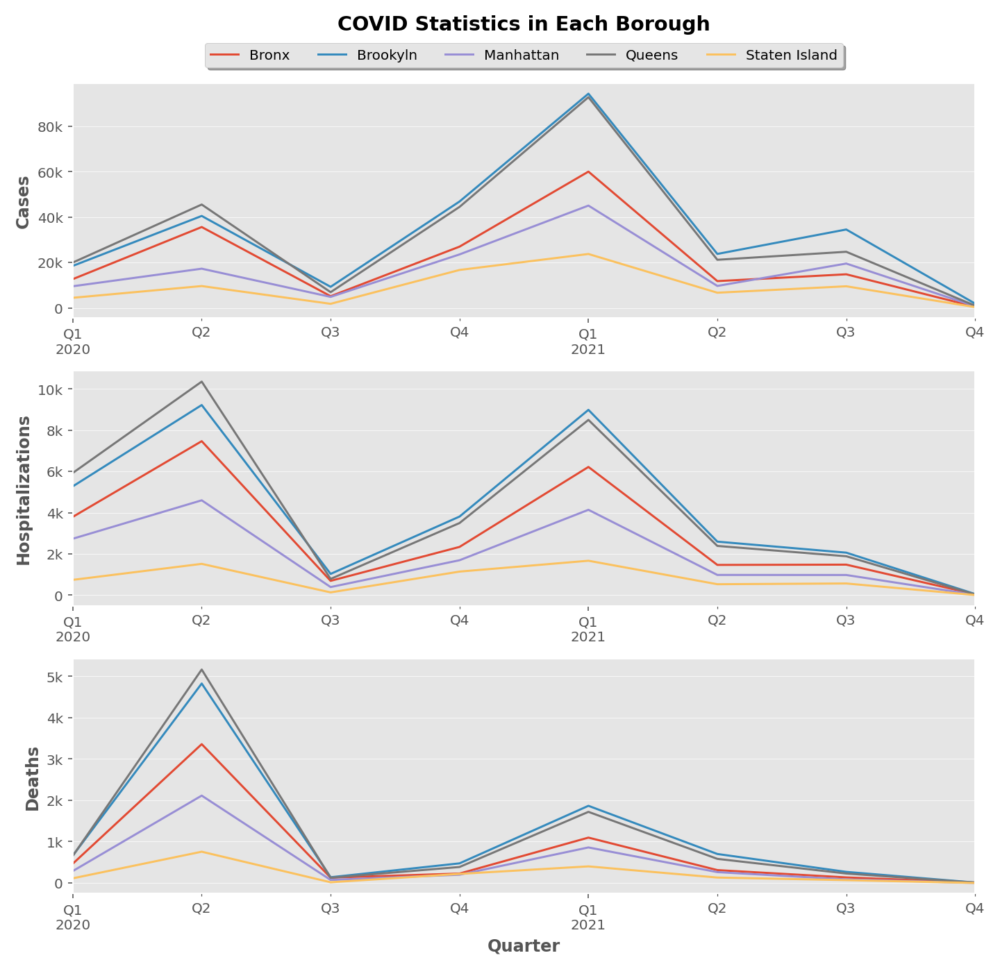

In [38]:
pn.Column(u_radio,trend_mpl_boro_line)

## Chart Series 5 - Matplotlib Line Charts - Effects of Vaccination

In [39]:
# Read data from the excel file and store in a pandas dataframe
df5 = pd.read_csv("daily-statistics.csv")

In [40]:
# Explore data
df5.head()

,Date,Cases,Hospitalizations,Deaths,Vaccine Doses,Cumulative Vaccine Doses
0,02/29/2020,1,1,0,0,0
1,03/01/2020,0,1,0,0,0
2,03/02/2020,0,2,0,0,0
3,03/03/2020,1,7,0,0,0
4,03/04/2020,5,2,0,0,0


In [41]:
# Define function to create line chart
def trend_mpl_boro_line_vac():
    
    # Create the figure container and subplot
    
    rFig = plt.Figure(figsize=(10,9.5),tight_layout = True)
    rPlot = rFig.add_subplot(311)
    rPlot1 = rFig.add_subplot(312)
    rPlot2 = rFig.add_subplot(313)
    
    # Convert date to pandas date time type
    df5['Date'] = pd.to_datetime(df5['Date'])
    
    # Group by date column on every quarter
    dframe = df5.groupby(pd.Grouper(key='Date',freq='QS')).sum()
    dframe = dframe.reset_index() 

    # Plot line chart for cases, hospitalization and deaths with cumulative vaccine line on each
    ax1a = dframe.plot.line('Date', 'Cases', ax=rPlot, legend = False)
    ax1b = dframe.plot.line('Date', 'Cumulative Vaccine Doses', secondary_y=True, ax=rPlot, legend = False)

    ax2a = dframe.plot.line('Date', 'Hospitalizations', ax=rPlot1, legend = False)
    ax2b = dframe.plot.line('Date', 'Cumulative Vaccine Doses', secondary_y=True, ax=rPlot1, legend = False)
    
    ax3a = dframe.plot.line('Date', 'Deaths', ax=rPlot2, legend = False)
    ax3b = dframe.plot.line('Date', 'Cumulative Vaccine Doses', secondary_y=True, ax=rPlot2, legend = False)
        
    
    # Loop over each plot and fix label tick format
    stats_list = [ax1a, ax2a, ax3a]
    
    for s in stats_list:
        s.yaxis.set_major_formatter(tick.FuncFormatter(reformat_large_tick_values))    
    
    vaccine_list = [ax1b, ax2b, ax3b]
    
    for v in vaccine_list:
        v.set_ylabel('Cumulative Vaccine Doses',color = '#03719c')
        v.yaxis.set_major_formatter(tick.FuncFormatter(reformat_large_tick_values))
    
    # Add chart title
    ax1a.set_title("The Effects of Vaccination vs. COVID Statistics in NYC\n\n", fontweight = 'bold')
    
    # Add axis labels for all charts
    ax1a.set_ylabel('Cases', color = 'tab:red')
    ax2a.set_ylabel('Hospitalizations', color = 'tab:red')
    ax3a.set_ylabel('Deaths', color = 'tab:red')
    ax1a.set_xlabel('')
    ax2a.set_xlabel('')
    ax3a.set_xlabel('Quarter', fontweight = 'bold') 
    
    # Adjust legend box for each plot
    ax1a.legend(loc='upper center', bbox_to_anchor=(0.374, 1.2),
          fancybox=True, shadow=True, ncol=5)
    ax1b.legend(loc='upper center', bbox_to_anchor=(0.65, 1.2),
          fancybox=True, shadow=True, ncol=5)
    
    ax2a.legend(loc='upper center', bbox_to_anchor=(0.374, 1.2),
          fancybox=True, shadow=True, ncol=5)
    ax2b.legend(loc='upper center', bbox_to_anchor=(0.65, 1.2),
          fancybox=True, shadow=True, ncol=5)
    
    ax3a.legend(loc='upper center', bbox_to_anchor=(0.374, 1.2),
          fancybox=True, shadow=True, ncol=5)
    ax3b.legend(loc='upper center', bbox_to_anchor=(0.65, 1.2),
          fancybox=True, shadow=True, ncol=5)

    # return the figure on function call
    return rFig 

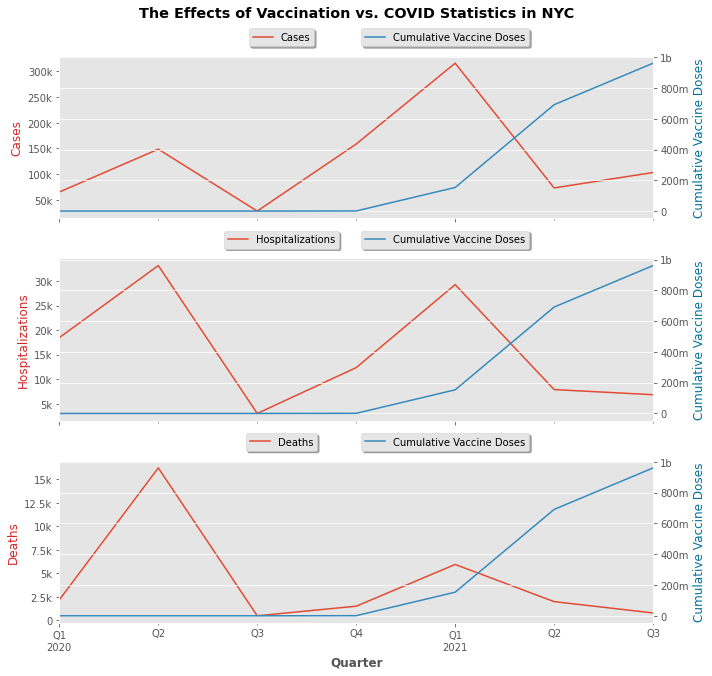

In [42]:
# Preview function output
trend_mpl_boro_line_vac()

## Chart Series 6 - Matplotlib Line Charts - Vaccination Distribution

In [43]:
# Read data from the excel file and store in a pandas dataframe
df6 = pd.read_csv("coverage-by-demo.csv")

In [44]:
# Explore data
df6.head()

,GROUP,SUBGROUP,POP_DENOMINATOR,COUNT_PARTIALLY_CUMULATIVE,COUNT_FULLY_CUMULATIVE,COUNT_1PLUS_CUMULATIVE,PERC_PARTIALLY,Percent Fully Vaccinated,Percent Partially or Fully Vaccinated
0,Age Group,0-17,1704122.18000,50528,358954,409482,2.97000,21.06000,24.03000
1,Age Group,18-24,704670.82000,83365,525409,608774,11.83000,74.56000,86.39000
2,Age Group,25-34,1483699.00000,132053,1078458,1210511,8.90000,72.69000,81.59000
3,Age Group,35-44,1136906.00000,91227,941768,1032995,8.02000,82.84000,90.86000
4,Age Group,45-54,1028087.00000,64511,865836,930347,6.27000,84.22000,90.49000


In [45]:
# Add Radio Button widget for factor selection
uField1 = pn.widgets.RadioButtonGroup(name="Select Factor", value = 'Borough', options= list(set(df6.GROUP)))
uField1

RadioButtonGroup(name='Select Factor', options=['Race', 'Sex', ...], value='Borough')

In [46]:
# Define reactive function to get matplotlib bar plots for vaccination distribution
@pn.depends(uField1)
def react_mpl_vac_stats(uFieldVar1):
    
    # Create the figure container and subplot
    rFig = plt.Figure(figsize=(10,8.5),tight_layout = True)
    rPlot = rFig.add_subplot(211)
    rPlot1 = rFig.add_subplot(212)
    
    
    # Get relevant columns
    dataframe = df6[["GROUP","SUBGROUP","COUNT_FULLY_CUMULATIVE","COUNT_1PLUS_CUMULATIVE", "POP_DENOMINATOR",
                     "Percent Fully Vaccinated","Percent Partially or Fully Vaccinated"]]
    
    # Filter based on widget selection
    dataframe = dataframe[dataframe["GROUP"] == str(uFieldVar1)]
    
    # Group by to get dataframe for plotting
    dframe_perc = dataframe.groupby(['SUBGROUP'])['Percent Fully Vaccinated','Percent Partially or Fully Vaccinated'].sum()
    dframe_count = dataframe.groupby(['SUBGROUP'])['COUNT_FULLY_CUMULATIVE','COUNT_1PLUS_CUMULATIVE'].sum()
    
    # Rename columns as necessary
    dframe_perc = dframe_perc.rename(columns={"Percent Fully Vaccinated":  "Fully Vaccinated" , 
                                              "Percent Partially or Fully Vaccinated": "Partially or Fully Vaccinated"})
    
    # Draw the required bar charts
    ax = dframe_count.plot(ax = rPlot, kind = 'bar', rot=0, xlabel = "",legend=False)
    ax1 = dframe_perc.plot(ax = rPlot1, kind = 'bar', rot=0,xlabel = "")

    
    # Define x axis label
    x_label = list(set(dataframe.GROUP))[0]
    
    # Add chart title
    ax.set_title(f"COVID Vaccination Statistics by {x_label}", fontweight = 'bold')
    
    # Add axis labels
    ax1.set_xlabel(f"{x_label}", fontweight = 'bold')
    ax.set_ylabel('Vaccination Doses', fontweight = 'bold')
    ax1.set_ylabel('Vaccination Doses Per Capita', fontweight = 'bold')
    
    # Remove vertical grid lines and adjust brightness on y-axis grid lines to ensure focus on data
    axis_lst = [ax, ax1]
    
    for axis in axis_lst:
        axis.grid(linestyle='-', linewidth=0.35, axis = 'y')
        axis.grid(b=None, axis = 'x')
        
    # Format axis ticks
    ax.yaxis.set_major_formatter(tick.FuncFormatter(reformat_large_tick_values)) 
    ax1.yaxis.set_major_formatter(tick.PercentFormatter())
    
    # Legend added to the corner to avoid clash with data 
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, 1.14),
          fancybox=True, shadow=True, ncol=2)
    
    rects = ax1.patches
        
    bar_heights = []
        
    # Loop over each bar to display distribution percentage values
    for num, rect in enumerate(rects):

        # Get X and Y placement of label from rect
        x_height = rect.get_height()
        x_width = rect.get_width()
        x_loc = rect.get_x()


        # Number of points between bar and label
        space = 0
        # Vertical alignment for annotations
        ha = 'center'
        
        label = '{:,.0f}%'.format(x_height)
        
        if uFieldVar1 == "Age Group":
            size = 'x-small'
        elif uFieldVar1 == "Sex":
            size = 'large'
        else:
            size = 'medium'
                        

        axis.annotate(
            label,                      
            (x_loc + (x_width/2), x_height*0.95),       
            xytext=(space, 0),          
            textcoords='offset points', 
            va='center',                
            ha=ha,                      
            color = 'white',
            fontweight = 'bold',
            fontsize = size
        )          
            
    # return the figure on function call
    return rFig 

Column
    [0] RadioButtonGroup(name='Select Factor', options=['Race', 'Sex', ...], value='Borough')
    [1] ParamFunction(function)
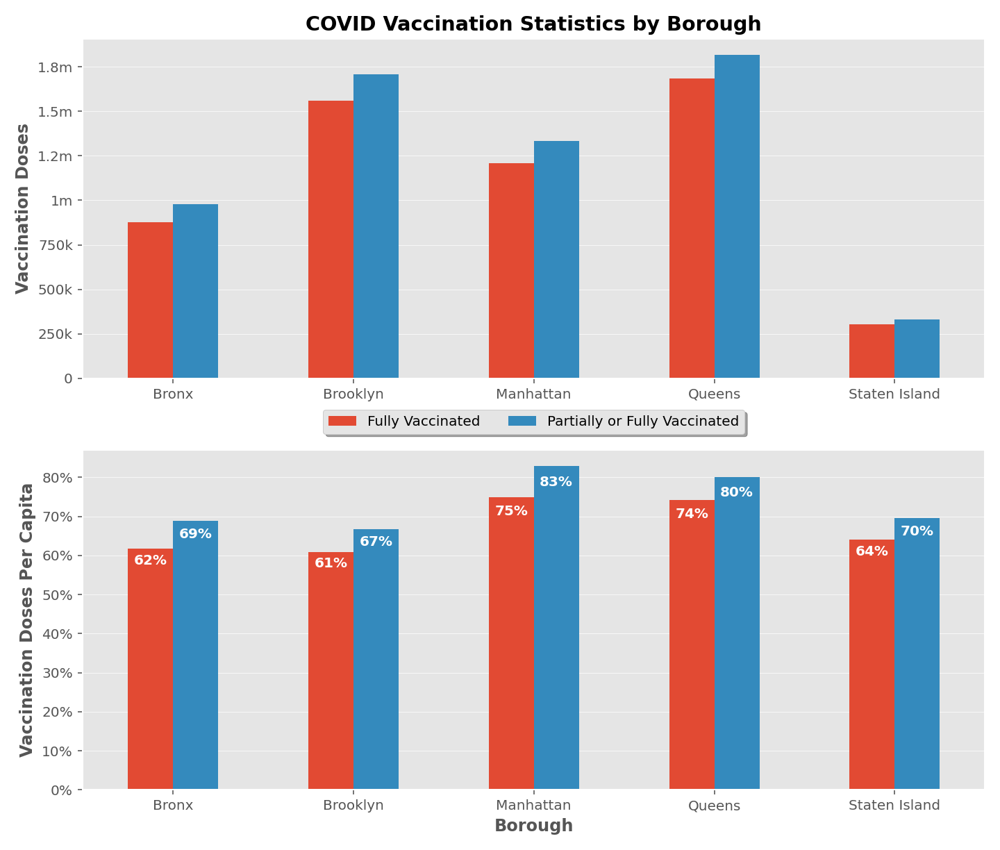

In [47]:
# Preview plot with widget
pn.Column(uField1, react_mpl_vac_stats)

## Chart Series 7 - Matplotlib Bar Plots - Multivariate Analysis - Statistics

In [48]:
# Read data from the excel file and store in a pandas dataframe
df7 = pd.read_csv("coverage-by-boro-demo-fully.csv")

In [49]:
# Explore data
df7.head()

,DATE,AGE_GROUP,RACE_ETHNICITY,CITY_COUNT_FULLY_CUMULATIVE,BX_COUNT_FULLY_CUMULATIVE,BK_COUNT_FULLY_CUMULATIVE,MH_COUNT_FULLY_CUMULATIVE,QS_COUNT_FULLY_CUMULATIVE,SI_COUNT_FULLY_CUMULATIVE,CITY_PERC_FULLY,BK_PERC_FULLY,BX_PERC_FULLY,MH_PERC_FULLY,QS_PERC_FULLY,SI_PERC_FULLY
0,2021-11-07,Boroughwide,Boroughwide,5634056,877069,1560048,1207873,1683681,305385,67.58000,60.94000,61.72000,74.96000,74.23000,64.14000
1,2021-11-07,All ages,Asian/NHPI,993598,38589,262937,162801,489372,39899,80.54000,82.19000,66.61000,80.25000,81.32000,77.96000
2,2021-11-07,All ages,Black,833295,185581,344461,101222,181335,20696,45.64000,45.29000,45.06000,50.64000,44.36000,46.32000
3,2021-11-07,All ages,Hispanic/Latino,1424255,412397,273624,263361,428784,46089,58.77000,56.57000,51.22000,64.57000,67.18000,52.00000
4,2021-11-07,All ages,White,1416588,66739,431107,479124,292635,146983,52.82000,45.80000,52.15000,62.66000,51.85000,51.81000


In [50]:
# Rename columns as necessary
df7 = df7.rename(columns={"AGE_GROUP": "Age Group", "RACE_ETHNICITY": "Race", 
                                "BK_PERC_FULLY": "Brooklyn", "BX_PERC_FULLY": "Bronx",
                                "MH_PERC_FULLY": "Manhattan","QS_PERC_FULLY": "Queens",
                                "SI_PERC_FULLY": "Staten Island"})

In [51]:
# Read data from second excel file and store in a pandas dataframe# 
df7a = pd.read_csv("group-data-by-boro.csv")

In [52]:
# Explore data in this table
df7a.tail()

,group,subgroup,BK_CONFIRMED_CASE_COUNT,BK_PROBABLE_CASE_COUNT,BK_CASE_COUNT,BK_HOSPITALIZED_COUNT,BK_DEATH_COUNT,BK_CONFIRMED_CASE_RATE,BK_CASE_RATE,BK_HOSPITALIZED_RATE,...,QN_DEATH_RATE,SI_CONFIRMED_CASE_COUNT,SI_PROBABLE_CASE_COUNT,SI_CASE_COUNT,SI_HOSPITALIZED_COUNT,SI_DEATH_COUNT,SI_CONFIRMED_CASE_RATE,SI_CASE_RATE,SI_HOSPITALIZED_RATE,SI_DEATH_RATE
9,Race,Black/African-American,61178,12120,73298,12633,3896.00000,7814.72000,9431.93000,1425.60000,...,372.94000,5181,951,6132,789,196.00000,11538.86000,13680.88000,1795.28000,491.96000
10,Race,Hispanic/Latino,45291,11095,56386,6483,1967.00000,9384.45000,11662.90000,1414.85000,...,485.26000,12059,3059,15118,1393,265.00000,13863.81000,17225.98000,1903.58000,444.54000
11,Race,White,75089,17152,92241,10956,3489.00000,7880.91000,9704.32000,1040.62000,...,263.85000,37405,6999,44404,3848,1259.00000,13363.83000,16020.34000,988.24000,290.47000
12,Sex,Female,141488,30507,171995,17477,4660.00000,10498.41000,12762.03000,1296.79000,...,356.73000,37000,7479,44479,3163,847.00000,15113.58000,18168.56000,1292.01000,345.98000
13,Sex,Male,127695,25170,152865,18397,6149.00000,10534.20000,12610.61000,1517.66000,...,558.10000,35880,6672,42552,3576,1071.00000,15510.31000,18394.50000,1545.84000,462.97000


In [53]:
# Rename columns as necessary
df7a = df7a.rename(columns={"BK_CASE_RATE": "Brooklyn", "BK_HOSPITALIZED_RATE": "Brooklyn_Hosp",
                          "BK_DEATH_RATE": "Brooklyn_Deaths",
                          "BX_CASE_RATE": "Bronx", "BX_HOSPITALIZED_RATE": "Bronx_Hosp",
                          "BX_DEATH_RATE": "Bronx_Deaths",
                          "MN_CASE_RATE": "Manhattan", "MN_HOSPITALIZED_RATE": "Manhattan_Hosp",
                          "MN_DEATH_RATE": "Manhattan_Deaths",
                          "QN_CASE_RATE": "Queens", "QN_HOSPITALIZED_RATE": "Queens_Hosp",
                          "QN_DEATH_RATE": "Queens_Deaths",
                          "SI_CASE_RATE": "StatenIsland", "SI_HOSPITALIZED_RATE": "StatenIsland_Hosp",
                          "SI_DEATH_RATE": "StatenIsland_Deaths"}) 

In [54]:
# Add Radio button widget for factor selection
uField2 = pn.widgets.RadioButtonGroup(name="Select Factor", value = 'Age Group', options= ['Age Group','Race'])

uField2a = pn.widgets.RadioButtonGroup(name="Select Factor", value = 'Sex', options= list(set(df7a['group'])))
uField2a

RadioButtonGroup(name='Select Factor', options=['Race', 'Sex', 'Age'], value='Sex')

In [55]:
# Define reactive function to draw matplotlib bar plots
@pn.depends(uField2a)
def react_mpl_stats_disp(uField2aVar):
    
    
    # Create the figure container and subplot
    rFig = plt.Figure(figsize=(12,8), tight_layout = True)
    rPlot = rFig.add_subplot(311)
    rPlot1 = rFig.add_subplot(312)
    rPlot2 = rFig.add_subplot(313)

    # Create empty dataframes
    dataframe = pd.DataFrame()
    dataframe1 = pd.DataFrame()
    dataframe2 = pd.DataFrame()
    
    # Filter based on selection
    dataframe = df7a[df7a['group'] == uField2aVar]
    dataframe = dataframe.groupby(['subgroup'])['Brooklyn','Bronx','Manhattan',
                              'Queens','StatenIsland'].mean()
    
    dataframe1 = df7a[df7a['group'] == uField2aVar]
    dataframe1 = dataframe1.groupby(['subgroup'])['Brooklyn_Hosp','Bronx_Hosp','Manhattan_Hosp',
                              'Queens_Hosp','StatenIsland_Hosp'].mean()
    
    dataframe2 = df7a[df7a['group'] == uField2aVar]
    dataframe2 = dataframe2.groupby(['subgroup'])['Brooklyn_Deaths','Bronx_Deaths','Manhattan_Deaths',
                              'Queens_Deaths','StatenIsland_Deaths'].mean()
 
    # Draw the required bar charts
    ax = dataframe.plot(ax = rPlot, kind = 'bar', width=0.8, rot=0, xlabel = "")
    ax1 = dataframe1.plot(ax = rPlot1, kind = 'bar', width=0.8, rot=0, xlabel = "", legend = False)
    ax2 = dataframe2.plot(ax = rPlot2, kind = 'bar', width=0.8, rot=0, xlabel = "", legend = False)
    
        
    
    # Add chart title
    ax.set_title(f"COVID Statistics Disparity by {uField2aVar}" + "\n\n", fontweight = 'bold')
    
    # Define x label
    ax2.set_xlabel(f"{uField2aVar}", fontweight = 'bold')
    
    # Add axis labels for all charts
    ax.set_ylabel('Cases Rate', fontweight = 'bold')
    ax1.set_ylabel('Hospitalizations Rate', fontweight = 'bold')
    ax2.set_ylabel('Deaths Rate', fontweight = 'bold')
    
    # Format gridlines and axis tick format for each plot
    for axis in [ax, ax1, ax2]:
        axis.grid(linestyle='-', linewidth=0.32, axis = 'y')
        axis.grid(b=None, axis = 'x')
        axis.yaxis.set_major_formatter(tick.FuncFormatter(reformat_large_tick_values))
    
    # Legend added to the corner to avoid clash with data 
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.2),
          fancybox=True, shadow=True, ncol=5)
    
            
    # return the figure on function call
    return rFig 

Column
    [0] RadioButtonGroup(name='Select Factor', options=['Race', 'Sex', 'Age'], value='Sex')
    [1] ParamFunction(function)
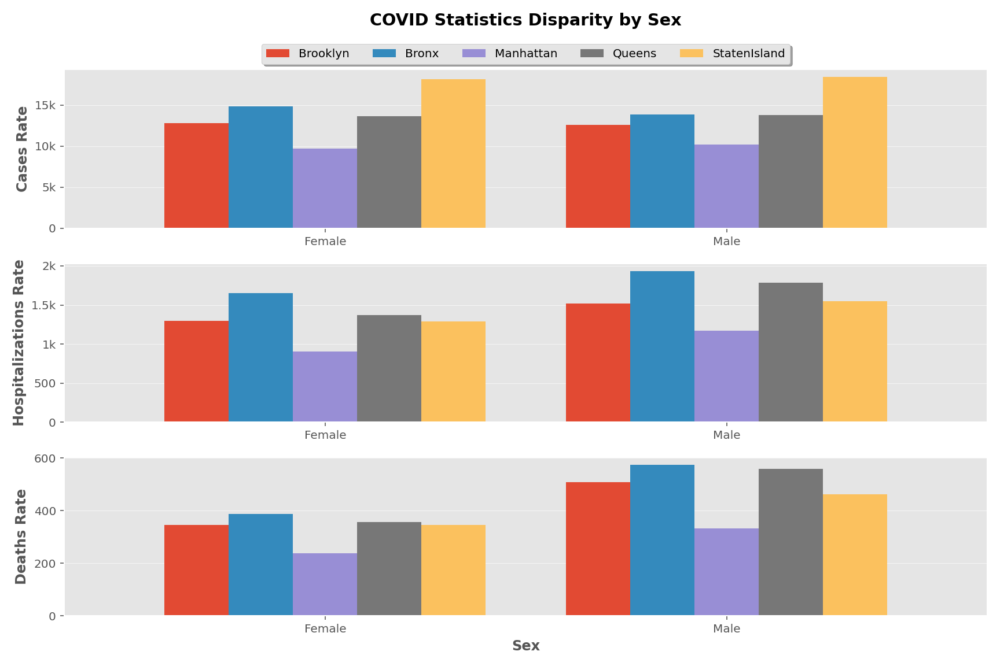

In [56]:
# Preview plot with widget
pn.Column(uField2a, react_mpl_stats_disp)

## Chart Series 8 - Matplotlib Bar Plots - Multivariate Analysis - Vaccinations

In [57]:
# Define reactive function to plot matplotlib bar plots
@pn.depends(uField2)
def react_mpl_vac_disp(uFieldVar2):
    
    # Create the figure container and subplot
    rFig = plt.Figure(figsize=(12,5), tight_layout = True)
    rPlot = rFig.add_subplot()
    
    # Group by based on widget variable
    dataframe = df7.groupby([uFieldVar2])['Brooklyn','Bronx','Manhattan','Queens','Staten Island'].mean()

    # Draw the required bar chart
    ax = dataframe.plot(ax = rPlot, kind = 'bar', width=0.8, rot=0, xlabel = "")
    
    
    # Add chart title
    ax.set_title(f"COVID Vaccination Disparity by {uFieldVar2}" + "\n\n", fontweight = 'bold')
    
    # Define x label
    ax.set_xlabel(f"{uFieldVar2}", fontweight = 'bold')
    
    # Add y labels for the chart
    ax.set_ylabel('Vaccination Percentage', fontweight = 'bold')

    # Format gridlines and tick labels
    ax.grid(linestyle='-', linewidth=0.32, axis = 'y')
    ax.grid(b=None, axis = 'x')
    ax.yaxis.set_major_formatter(tick.PercentFormatter())
    
    # Legend added to the corner to avoid clash with data 
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.12),
          fancybox=True, shadow=True, ncol=5)
    

    rects = ax.patches
        
    bar_heights = []
        
    # Loop over each bar to annotate with percentage distribution value
    for num, rect in enumerate(rects):

        # Get X and Y placement of label from rect
        x_height = rect.get_height()
        x_width = rect.get_width()
        x_loc = rect.get_x()


        # Number of points between bar and label
        space = 0
        # Vertical alignment for annotations
        ha = 'center'
        
        label = '{:,.0f}%'.format(x_height)                

        ax.annotate(
            label,                     
            (x_loc + (x_width/2), x_height*0.96),    
            xytext=(space, 0),          
            textcoords='offset points', 
            va='center',                
            ha=ha,                      
            color = 'white',
            fontweight = 'heavy',
            fontsize = 'small',
        )          
            
    # return the figure on function call
    return rFig 

Column
    [0] RadioButtonGroup(name='Select Factor', options=['Age Group', 'Race'], value='Age Group')
    [1] ParamFunction(function)
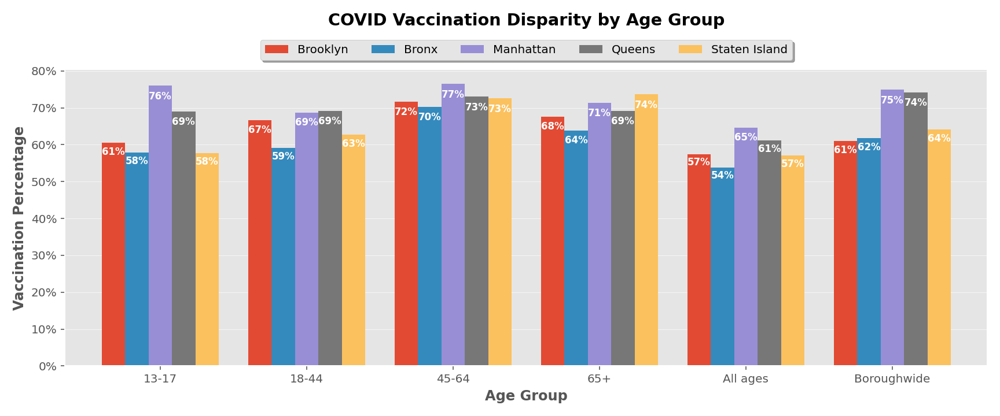

In [58]:
# Preview plot with widget
pn.Column(uField2, react_mpl_vac_disp)

## Chart Series 9 - Bokeh Linked Brushing Scatter Plots - Targeted Focus - Correlation

In [59]:
# Read data from the excel file and store in a pandas dataframe
df8 = pd.read_csv("daily-statistics-v1.csv")

In [60]:
# Explore data
df8.head()

,Date,Daily Cases,Daily Hospitalizations,Daily Deaths,Daily Vaccine Doses,Cumulative Vaccine Doses
0,2/29/20,1,1,0,nan,nan
1,3/1/20,0,1,0,nan,nan
2,3/2/20,0,2,0,nan,nan
3,3/3/20,1,7,0,nan,nan
4,3/4/20,5,2,0,nan,nan


In [61]:
# Convert pd dataframe to Bokeh CDS to allow for rendering (specifically linked brushing)
df8CDS = ColumnDataSource(df8)

In [62]:
# Define function to create bokeh scatter plots
def bokeh_plot_brush():
    
    # Tools to be shown on the plot
    TOOLS = "box_select, box_zoom, reset,pan, hover,lasso_select,help, save"
    
    # Format text for hovertool
    cases_hoverText = [('Date', "@{Date}"),('Cases',"@{Daily Cases}"), ('Total Vaccine Doses',"@{Cumulative Vaccine Doses}")]

    # Create a new figure container 
    cases = figure(tools=TOOLS, plot_width=450, plot_height=320, x_axis_label= 'Cumulative Vaccine Doses', y_axis_label= 'Daily Cases', title="Daily Cases vs. Increasing Vaccine Doses",  tooltips = cases_hoverText)
    
    # Add a circle renderer
    cases.circle('Cumulative Vaccine Doses', 'Daily Cases', alpha=.6,  
                
                # Setting behavior for what happens when glyphs are selected/not selected.
                nonselection_fill_alpha=0.2, nonselection_fill_color="gray", 
                nonselection_line_color="gray", nonselection_line_alpha=0.2,
                
                # Setting the data source to autoCDS. This will also automatically allow for linked brushing
                source=df8CDS)
    
    # Starting the x- and y-range at 0 
    cases.y_range.start = 0
    cases.x_range.start = 0
      
    # Format text for hovertool
    deaths_hoverText = [('Date', "@{Date}"),('Deaths',"@{Daily Deaths}"), ('Total Vaccine Doses',"@{Cumulative Vaccine Doses}")]
    
    # Create the second scatter plot with a square renderer
    deaths = figure(tools=TOOLS, plot_width=450, plot_height=320, x_axis_label= 'Cumulative Vaccine Doses', y_axis_label= 'Daily Deaths', title="Daily Deaths vs. Increasing Vaccine Doses", tooltips = deaths_hoverText)
    
    deaths.square('Cumulative Vaccine Doses','Daily Deaths', source=df8CDS)
    
    
    # Format text for hovertool
    hosps_hoverText = [('Date', "@{Date}"),('Hospitalizations',"@{Daily Hospitalizations}"), ('Total Vaccine Doses',"@{Cumulative Vaccine Doses}")]
    
    # Create the third scatter plot with a square renderer
    hosps = figure(tools=TOOLS, plot_width=450, plot_height=320, x_axis_label= 'Cumulative Vaccine Doses', y_axis_label= 'Daily Hospitalizations', title="Daily Hospitalizations vs. Increasing Vaccine Doses", tooltips =hosps_hoverText)

    hosps.square('Cumulative Vaccine Doses','Daily Hospitalizations', source=df8CDS)
    
    
    # Format text for hovertool
    vacs_hoverText = [('Date', "@{Date}"),('Vaccine Doses',"@{Daily Vaccine Doses}"), ('Total Vaccine Doses',"@{Cumulative Vaccine Doses}")]
    
    # Create the fourth scatter plot with a square renderer
    vacs = figure(tools=TOOLS, plot_width=450, plot_height=320, x_axis_label= 'Cumulative Vaccine Doses', y_axis_label= 'Daily Vaccine Doses', title="Daily Vaccine Doses vs. Cumulative Vaccine Doses", tooltips = vacs_hoverText)
    
    vacs.square('Cumulative Vaccine Doses','Daily Vaccine Doses', source=df8CDS)
    
    # Loop over each plot and fix tick formats
    for fig in [vacs,cases,hosps,deaths]:
        fig.xaxis.formatter = NumeralTickFormatter(format = '0a')
        fig.yaxis.formatter = NumeralTickFormatter(format = '0a')

    # Use gridplot to organize the four charts
    bkPlot = gridplot([[vacs,cases],[hosps,deaths]])
    
    
    # Wrapping the bokeh gridplot in Panel's .Bokeh pane. 
    bokeh_pane = pn.pane.Bokeh(bkPlot)
    
    # returning bokeh pane object
    return bokeh_pane

In [63]:
# Preview plot
pn.Column(bokeh_plot_brush)

Column
    [0] Column
        [0] Column()
        [1] Row
            [0] Bokeh(Column)

## Chart Series 10 - Plotly Linked Brushing Scatter Matrix Plots - Correlation Exploration

In [64]:
# Define function to create plotly scatter plot matrix
def plotly_scatter_matrix():
    

    # Filter dataframe to contain only necessary columns
    df8a = df8[["Daily Cases","Daily Hospitalizations","Daily Deaths","Cumulative Vaccine Doses"]]

    # Rename columns as necessary
    df8a = df8a.rename(columns={"Daily Cases":"Cases","Daily Hospitalizations": "Hospitalizations", 
                                "Daily Deaths": "Deaths","Daily Vaccine Doses": "Vaccine Doses"})

    # Plot plotly scatterplot matrix
    fig = px.scatter_matrix(df8a, title="Scatter Plot Correlation Matrix - COVID Statistics", height=800, width = 800)
    
    return fig

In [65]:
# Preview plot
plotly_scatter_matrix()

## Chart Series 11 - GeoPandas Plots - Geographical Data Comparison

In [66]:
# Read data from the csv file and store in a pandas dataframe
df9 = pd.read_csv("coverage-by-modzcta-allages.csv")

In [67]:
# Explore data
df9.head()

,NEIGHBORHOOD_NAME,BOROUGH,ZipCode,POP_DENOMINATOR,COUNT_PARTIALLY_CUMULATIVE,COUNT_FULLY_CUMULATIVE,COUNT_1PLUS_CUMULATIVE,PERC_PARTIALLY,PERC_FULLY,PERC_1PLUS
0,Chelsea/NoMad/West Chelsea,Manhattan,10001,27613.09000,6324,29783,36107,22.90000,107.86000,130.76000
1,Chinatown/Lower East Side,Manhattan,10002,75322.71000,4567,61250,65817,6.06000,81.32000,87.38000
2,East Village/Gramercy/Greenwich Village,Manhattan,10003,53977.81000,3380,38702,42082,6.26000,71.70000,77.96000
3,Financial District,Manhattan,10004,2972.12000,465,3715,4180,15.65000,125.00000,140.64000
4,Financial District,Manhattan,10005,8757.23000,790,7665,8455,9.02000,87.53000,96.55000


In [68]:
# Transforming any 9 digit zipcodes to 5 digit zipcodes
df9['ZipCode'] = df9['ZipCode'].astype('str')
df9['ZipCode'] = df9['ZipCode'].str.slice(0, 5, 1) 

In [69]:
# Getting the data ready for choropleth map

# Read the NYC Zipcode geojson boundary file using geopandas
zipShape = gpd.read_file("zip_code_040114.geojson")

# Get mean for each zipcode
zip_full = df9.groupby(['NEIGHBORHOOD_NAME','BOROUGH','ZipCode'])['PERC_FULLY'].mean().reset_index()

# Combining (joining) the zip boundary shape data with 
zipYearCntShape = pd.merge(zipShape, zip_full, how='inner', left_on='ZIPCODE', right_on='ZipCode')

# Apply correct formatting to the zipcode fiels
zipYearCntShape['ZIPCODE'] = zipYearCntShape['ZIPCODE'].astype('str')
zipYearCntShape['ZIPCODE'] = zipYearCntShape['ZIPCODE'].str.slice(0, 5, 1) 

zipYearCntShape['ZipCode'] = zipYearCntShape['ZipCode'].astype('str')
zipYearCntShape['ZipCode'] = zipYearCntShape['ZipCode'].str.slice(0, 5, 1) 
zipYearCntShape.head()


,ZIPCODE,BLDGZIP,PO_NAME,POPULATION,AREA,STATE,COUNTY,ST_FIPS,CTY_FIPS,URL,SHAPE_AREA,SHAPE_LEN,geometry,NEIGHBORHOOD_NAME,BOROUGH,ZipCode,PERC_FULLY
0,11436,0,Jamaica,18681.00000,22699295.45941,NY,Queens,36,081,http://www.usps.com/,0.00000,0.00000,"POLYGON ((-73.80585 40.68291, -73.80569 40.682...",South Jamaica/South Ozone Park,Queens,11436,63.94000
1,11213,0,Brooklyn,62426.00000,29631004.43794,NY,Kings,36,047,http://www.usps.com/,0.00000,0.00000,"POLYGON ((-73.93740 40.67973, -73.93487 40.679...",Crown Heights (East),Brooklyn,11213,50.85000
2,11212,0,Brooklyn,83866.00000,41972104.07142,NY,Kings,36,047,http://www.usps.com/,0.00000,0.00000,"POLYGON ((-73.90294 40.67084, -73.90223 40.668...",Ocean Hill-Brownsville,Brooklyn,11212,57.82000
3,11225,0,Brooklyn,56527.00000,23698630.12493,NY,Kings,36,047,http://www.usps.com/,0.00000,0.00000,"POLYGON ((-73.95797 40.67066, -73.95576 40.670...",Crown Heights (West)/Prospect Lefferts Gardens,Brooklyn,11225,60.83000
4,11218,0,Brooklyn,72280.00000,36868798.98976,NY,Kings,36,047,http://www.usps.com/,0.00000,0.00000,"POLYGON ((-73.97208 40.65060, -73.97192 40.650...",Kensington/Windsor Terrace,Brooklyn,11218,61.57000


In [70]:
# Read data from the csv file and store in a pandas dataframe
df10 = pd.read_csv("data-by-modzcta.csv")
df10.head()

,MODIFIED_ZCTA,NEIGHBORHOOD_NAME,BOROUGH_GROUP,label,lat,lon,COVID_CONFIRMED_CASE_COUNT,COVID_PROBABLE_CASE_COUNT,COVID_CASE_COUNT,COVID_CONFIRMED_CASE_RATE,COVID_CASE_RATE,POP_DENOMINATOR,COVID_CONFIRMED_DEATH_COUNT,COVID_PROBABLE_DEATH_COUNT,COVID_DEATH_COUNT,COVID_CONFIRMED_DEATH_RATE,COVID_DEATH_RATE,PERCENT_POSITIVE,TOTAL_COVID_TESTS
0,10001,Chelsea/NoMad/West Chelsea,Manhattan,"10001, 10118",40.75069,-73.99714,2115,709,2824,7659.41000,10227.03000,27613.09000,38,6,44,137.62000,159.34000,6.45000,32626
1,10002,Chinatown/Lower East Side,Manhattan,10002,40.71578,-73.98618,7017,1632,8649,9315.92000,11482.59000,75322.71000,293,50,343,388.99000,455.37000,11.68000,59959
2,10003,East Village/Gramercy/Greenwich Village,Manhattan,10003,40.73183,-73.98916,3831,1094,4925,7097.36000,9124.12000,53977.81000,51,13,64,94.48000,118.57000,7.22000,52539
3,10004,Financial District,Manhattan,10004,40.70367,-74.01311,320,119,439,10766.74000,14770.62000,2972.12000,2,0,2,67.29000,67.29000,6.16000,5163
4,10005,Financial District,Manhattan,10005,40.70609,-74.00886,609,350,959,6954.26000,10950.96000,8757.23000,0,1,1,0.00000,11.42000,7.13000,8441


In [71]:
# Read data from the csv file and store in a pandas dataframe
df11 = pd.read_csv("antibody-by-modzcta.csv")
df11.head()

,modzcta_first,NEIGHBORHOOD_NAME,BOROUGH_GROUP,label,lat,lon,NUM_PEOP_TEST,NUM_PEOP_POS,PERCENT_POSITIVE,TEST_RATE
0,10001,Chelsea/NoMad/West Chelsea,Manhattan,"10001, 10118",40.75069,-73.99714,11594,3001,25.90000,41987.33400
1,10002,Chinatown/Lower East Side,Manhattan,10002,40.71578,-73.98618,32824,10935,33.30000,43577.82700
2,10003,East Village/Gramercy/Greenwich Village,Manhattan,10003,40.73183,-73.98916,19602,4344,22.20000,36314.92300
3,10004,Financial District,Manhattan,10004,40.70367,-74.01311,1610,352,21.90000,54170.16100
4,10005,Financial District,Manhattan,10005,40.70609,-74.00886,3399,723,21.30000,38813.66200


In [72]:
# Read data from the csv file and store in a pandas dataframe
df12 = pd.read_csv("income-data-by-modzcta.csv")
df12.head()

,MODIFIED_ZCTA,NEIGHBORHOOD_NAME,BOROUGH_GROUP,MEDIAN_INCOME
0,10001,Chelsea/NoMad/West Chelsea,Manhattan,92840.00000
1,10002,Chinatown/Lower East Side,Manhattan,36982.00000
2,10003,East Village/Gramercy/Greenwich Village,Manhattan,118161.00000
3,10004,Financial District,Manhattan,190223.00000
4,10005,Financial District,Manhattan,189702.00000


In [73]:
# Rename zip code columns
df10 = df10.rename(columns={"MODIFIED_ZCTA": "ZipCode", "BOROUGH_GROUP": "BOROUGH"})
df11 = df11.rename(columns={"modzcta_first": "ZipCode", "BOROUGH_GROUP": "BOROUGH"})
df12 = df12.rename(columns={"MODIFIED_ZCTA": "ZipCode", "BOROUGH_GROUP": "BOROUGH"})

In [74]:
# Transforming any 9 digit zipcodes to 5 digit zipcodes
dfs = [df10, df11, df12]

for d in dfs:
    d['ZipCode'] = d['ZipCode'].astype('str')
    d['ZipCode'] = d['ZipCode'].str.slice(0, 5, 1)

In [75]:
# Getting the data ready for choropleth map

# Read the NYC Zipcode geojson boundary file using geopandas
zipShape = gpd.read_file("zip_code_040114.geojson")

# Group by stats for each dataframe
zip_full = df10.groupby(['NEIGHBORHOOD_NAME','BOROUGH','ZipCode'])['COVID_CASE_RATE'].mean().reset_index()
zip_full_totals = df10.groupby(['NEIGHBORHOOD_NAME','BOROUGH','ZipCode'])['COVID_CASE_COUNT'].mean().reset_index()

zip_full_death = df10.groupby(['NEIGHBORHOOD_NAME','BOROUGH','ZipCode'])['COVID_DEATH_RATE'].mean().reset_index()
zip_full_death_totals = df10.groupby(['NEIGHBORHOOD_NAME','BOROUGH','ZipCode'])['COVID_DEATH_COUNT'].mean().reset_index()

zip_full_test = df11.groupby(['NEIGHBORHOOD_NAME','BOROUGH','ZipCode'])['TEST_RATE'].mean().reset_index()
zip_full_test_totals = df11.groupby(['NEIGHBORHOOD_NAME','BOROUGH','ZipCode'])['NUM_PEOP_TEST'].mean().reset_index()

zip_full_vac = df9.groupby(['NEIGHBORHOOD_NAME','BOROUGH','ZipCode'])['PERC_FULLY'].mean().reset_index()
zip_full_vac_totals = df9.groupby(['NEIGHBORHOOD_NAME','BOROUGH','ZipCode'])['COUNT_FULLY_CUMULATIVE'].mean().reset_index()

zip_full_income = df12.groupby(['NEIGHBORHOOD_NAME','BOROUGH','ZipCode'])['MEDIAN_INCOME'].mean().reset_index()

# Combining the zip boundary shape data with the stats data
zipYearCntShape = pd.merge(zipShape, zip_full, how='inner', left_on='ZIPCODE', right_on='ZipCode')
zipYearCntShape_totals = pd.merge(zipShape, zip_full_totals, how='inner', left_on='ZIPCODE', right_on='ZipCode')

zipYearCntShape_death = pd.merge(zipShape, zip_full_death, how='inner', left_on='ZIPCODE', right_on='ZipCode')
zipYearCntShape_death_totals = pd.merge(zipShape, zip_full_death_totals, how='inner', left_on='ZIPCODE', right_on='ZipCode')

zipYearCntShape_test = pd.merge(zipShape, zip_full_test, how='inner', left_on='ZIPCODE', right_on='ZipCode')
zipYearCntShape_test_totals = pd.merge(zipShape, zip_full_test_totals, how='inner', left_on='ZIPCODE', right_on='ZipCode')

zipYearCntShape_vac = pd.merge(zipShape, zip_full_vac, how='inner', left_on='ZIPCODE', right_on='ZipCode')
zipYearCntShape_vac_totals = pd.merge(zipShape, zip_full_vac_totals, how='inner', left_on='ZIPCODE', right_on='ZipCode')

zipYearCntShape_income = pd.merge(zipShape, zip_full_income, how='inner', left_on='ZIPCODE', right_on='ZipCode')





In [76]:
# Add radio box widget for totals vs per capita selection
u_radio1 = pn.widgets.RadioBoxGroup(name='RadioBoxGroup', value = "Per Capita", options=['Totals', 'Per Capita'], inline=True)

u_radio1

RadioBoxGroup(inline=True, options=['Totals', 'Per Capita'], value='Per Capita')

In [77]:
# Add Radio button widget for factor selection
uField4 = pn.widgets.RadioButtonGroup(name="Select Borough", value = 'All Boroughs', options= sorted(list(set(df10.BOROUGH)) + ["All Boroughs"]))
uField4

RadioButtonGroup(name='Select Borough', options=['All Boroughs', ...], value='All Boroughs')

In [78]:
# Add widget for the Select drop down list that allows for variable selection to be displayed on the left
uField5 = pn.widgets.Select(name="Select Left Variable", value = 'Cases', options= ["Cases", "Deaths", "Tests", "Vaccines", "Income"])
uField5

Select(options=['Cases', 'Deaths', ...], value='Cases')

In [79]:
# Add widget for the Select drop down list that allows for variable selection to be displayed on the right
uField6 = pn.widgets.Select(name="Select Right Variable", value = 'Income', options= ["Cases", "Deaths", "Tests", "Vaccines", "Income"])
uField6

Select(options=['Cases', 'Deaths', ...], value='Income')

In [80]:
# Reactive function to create geographical maps
@pn.depends(uField4, uField5, uField6, u_radio1)
def comparisonChoroMap(uField4Var, uField5Var, uField6Var, u_radio1Var):
    
    # Empty dataframes
    dframe = pd.DataFrame()
    dframe2 = pd.DataFrame()
    
    # Render based on widget selection
    if uField5Var == "Cases":
        palette = brewer['Reds'][9]
        if u_radio1Var == "Per Capita":
            y_var = "COVID_CASE_RATE"
            y_label = "Cases Rate Per Capita"
            if uField4Var == "All Boroughs":
                dframe = zipYearCntShape
            else:
                dframe = zipYearCntShape[zipYearCntShape["BOROUGH"] == str(uField4Var)]   
        elif u_radio1Var == "Totals":
            y_var = "COVID_CASE_COUNT"
            y_label = "Cases Count"
            if uField4Var == "All Boroughs":
                dframe = zipYearCntShape_totals
            else:
                dframe = zipYearCntShape_totals[zipYearCntShape_totals["BOROUGH"] == str(uField4Var)]  
                
    elif uField5Var == "Deaths":
        palette = brewer['Greys'][9]
        if u_radio1Var == "Per Capita":
            y_var = "COVID_DEATH_RATE"
            y_label = "Deaths Rate Per Capita"
            if uField4Var == "All Boroughs":
                dframe = zipYearCntShape_death
            else:
                dframe = zipYearCntShape_death[zipYearCntShape_death["BOROUGH"] == str(uField4Var)]   
        elif u_radio1Var == "Totals":
            y_var = "COVID_DEATH_COUNT"
            y_label = "Deaths Count"
            if uField4Var == "All Boroughs":
                dframe = zipYearCntShape_death_totals
            else:
                dframe = zipYearCntShape_death_totals[zipYearCntShape_death_totals["BOROUGH"] == str(uField4Var)]         
                
    elif uField5Var == "Tests":
        palette = brewer['Blues'][9]
        if u_radio1Var == "Per Capita":
            y_var = "TEST_RATE"
            y_label = "Tests Rate Per Capita"
            if uField4Var == "All Boroughs":
                dframe = zipYearCntShape_test
            else:
                dframe = zipYearCntShape_test[zipYearCntShape_test["BOROUGH"] == str(uField4Var)]   
        elif u_radio1Var == "Totals":
            y_var = "NUM_PEOP_TEST"
            y_label = "Tests Count"
            if uField4Var == "All Boroughs":
                dframe = zipYearCntShape_test_totals
            else:
                dframe = zipYearCntShape_test_totals[zipYearCntShape_test_totals["BOROUGH"] == str(uField4Var)]
                
                
    elif uField5Var == "Vaccines":
        palette = brewer['Greens'][9]
        if u_radio1Var == "Per Capita":
            y_var = "PERC_FULLY"
            y_label = "Vaccines Rate Per Capita"
            if uField4Var == "All Boroughs":
                dframe = zipYearCntShape_vac
            else:
                dframe = zipYearCntShape_vac[zipYearCntShape_vac["BOROUGH"] == str(uField4Var)]   
        elif u_radio1Var == "Totals":
            y_var = "COUNT_FULLY_CUMULATIVE"
            y_label = "Vaccine Doses Count"
            if uField4Var == "All Boroughs":
                dframe = zipYearCntShape_vac_totals
            else:
                dframe = zipYearCntShape_vac_totals[zipYearCntShape_vac_totals["BOROUGH"] == str(uField4Var)]
                
    elif uField5Var == "Income":
        y_var = "MEDIAN_INCOME"
        y_label = "Median Household Income"
        palette = brewer['Purples'][9]
        if uField4Var == "All Boroughs":
            dframe = zipYearCntShape_income
        else:
            dframe = zipYearCntShape_income[zipYearCntShape_income["BOROUGH"] == str(uField4Var)]
    
    # Right chart
    if uField6Var == "Cases":
        palette2 = brewer['Reds'][9]
        if u_radio1Var == "Per Capita":
            y_var2 = "COVID_CASE_RATE"
            y_label2 = "Cases Rate Per Capita"
            if uField4Var == "All Boroughs":
                dframe2 = zipYearCntShape
            else:
                dframe2 = zipYearCntShape[zipYearCntShape["BOROUGH"] == str(uField4Var)]   
        elif u_radio1Var == "Totals":
            y_var2 = "COVID_CASE_COUNT"
            y_label2 = "Cases Count"
            if uField4Var == "All Boroughs":
                dframe2 = zipYearCntShape_totals
            else:
                dframe2 = zipYearCntShape_totals[zipYearCntShape_totals["BOROUGH"] == str(uField4Var)]  
                
    elif uField6Var == "Deaths":
        palette2 = brewer['Greys'][9]
        if u_radio1Var == "Per Capita":
            y_var2 = "COVID_DEATH_RATE"
            y_label2 = "Deaths Rate Per Capita"
            if uField4Var == "All Boroughs":
                dframe2 = zipYearCntShape_death
            else:
                dframe2 = zipYearCntShape_death[zipYearCntShape_death["BOROUGH"] == str(uField4Var)]   
        elif u_radio1Var == "Totals":
            y_var2 = "COVID_DEATH_COUNT"
            y_label2 = "Deaths Count"
            if uField4Var == "All Boroughs":
                dframe2 = zipYearCntShape_death_totals
            else:
                dframe2 = zipYearCntShape_death_totals[zipYearCntShape_death_totals["BOROUGH"] == str(uField4Var)]         
                
    elif uField6Var == "Tests":
        palette2 = brewer['Blues'][9]
        if u_radio1Var == "Per Capita":
            y_var2 = "TEST_RATE"
            y_label2 = "Tests Rate Per Capita"
            if uField4Var == "All Boroughs":
                dframe2 = zipYearCntShape_test
            else:
                dframe2 = zipYearCntShape_test[zipYearCntShape_test["BOROUGH"] == str(uField4Var)]   
        elif u_radio1Var == "Totals":
            y_var2 = "NUM_PEOP_TEST"
            y_label2 = "Tests Count"
            if uField4Var == "All Boroughs":
                dframe2 = zipYearCntShape_test_totals
            else:
                dframe2 = zipYearCntShape_test_totals[zipYearCntShape_test_totals["BOROUGH"] == str(uField4Var)]
                
                
    elif uField6Var == "Vaccines":
        palette2 = brewer['Greens'][9]
        if u_radio1Var == "Per Capita":
            y_var2 = "PERC_FULLY"
            y_label2 = "Vaccines Rate Per Capita"
            if uField4Var == "All Boroughs":
                dframe2 = zipYearCntShape_vac
            else:
                dframe2 = zipYearCntShape_vac[zipYearCntShape_vac["BOROUGH"] == str(uField4Var)]   
        elif u_radio1Var == "Totals":
            y_var2 = "COUNT_FULLY_CUMULATIVE"
            y_label2 = "Vaccine Doses Count"
            if uField4Var == "All Boroughs":
                dframe2 = zipYearCntShape_vac_totals
            else:
                dframe2 = zipYearCntShape_vac_totals[zipYearCntShape_vac_totals["BOROUGH"] == str(uField4Var)]
                
    elif uField6Var == "Income":
        palette2 = brewer['Purples'][9]
        y_var2 = "MEDIAN_INCOME"
        y_label2 = "Median Household Income"
        if uField4Var == "All Boroughs":
            dframe2 = zipYearCntShape_income
        else:
            dframe2 = zipYearCntShape_income[zipYearCntShape_income["BOROUGH"] == str(uField4Var)]
            
    

    # Convert the merged shape count file to geojson format needed for bokeh 
    json_data = json.dumps(json.loads(dframe.to_json()))
    geozipCntShape = GeoJSONDataSource(geojson = json_data)
    
    json_data2 = json.dumps(json.loads(dframe2.to_json()))
    geozipCntShape2 = GeoJSONDataSource(geojson = json_data2)
    
    # Which interactive tools you want
    tools = 'box_zoom,pan,reset,hover, save'

    # What to show when hovering over
    if uField4Var == "All Boroughs":
        hoverText = [('Borough',"@BOROUGH"),('Zipcode',"@ZIPCODE"), ('Neighborhood',"@NEIGHBORHOOD_NAME"), (y_label,"@" + y_var)]
        hoverText2 = [('Borough',"@BOROUGH"),('Zipcode',"@ZIPCODE"), ('Neighborhood',"@NEIGHBORHOOD_NAME"), (y_label2,"@" + y_var2)]
        plotTitle =  y_label + " across NYC"
        plotTitle2 =  y_label2 + " across NYC"
        
    else:
        hoverText = [('Zipcode',"@ZIPCODE"), ('Neighborhood',"@NEIGHBORHOOD_NAME"), (y_label,"@" + y_var)]
        hoverText2 = [('Zipcode',"@ZIPCODE"), ('Neighborhood',"@NEIGHBORHOOD_NAME"), (y_label2,"@" + y_var2)]
        plotTitle =  y_label + " across " +  uField4Var
        plotTitle2 = y_label2 + " across " +  uField4Var
    
    # Create the figures
    p = figure(title = plotTitle, plot_height=500 , plot_width=500, 
               toolbar_location='right', tools=tools, tooltips=hoverText, sizing_mode='scale_both')
    
    p2 = figure(title = plotTitle2, plot_height=450 , plot_width=450, 
               toolbar_location='right', tools=tools, tooltips=hoverText2, sizing_mode='scale_both')
    
    
    # Configure axes
    for f in [p,p2]:
        f.xaxis.visible = False
        f.yaxis.visible = False
        
        # No gridlines
        f.xgrid.grid_line_color = None
        f.ygrid.grid_line_color = None

    # Create the colormap based legend with LinearColorMapper and ColorBa
    palette = palette[::-1]
    palette2 = palette2[::-1]

    # Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
    DC_mapper = LinearColorMapper(palette = palette, 
                                  low = dframe[y_var].min(), 
                                  high = dframe[y_var].max())
    
    DC_mapper2 = LinearColorMapper(palette = palette2, 
                                  low = dframe2[y_var2].min(), 
                                  high = dframe2[y_var2].max())
    
    color_bar = ColorBar(color_mapper=DC_mapper, label_standoff=5, width=300, height=20,
                         location=(0,0), orientation='horizontal', formatter = NumeralTickFormatter(format = '0a'))
    
    color_bar2 = ColorBar(color_mapper=DC_mapper2, label_standoff=5, width=300, height=20,
                         location=(0,0), orientation='horizontal', formatter = NumeralTickFormatter(format = '0a'))

    # Use the patch renderer option to add zipcode boundary shapes to the figure.
    p.patches('xs','ys', source=geozipCntShape, fill_alpha=1, line_width=0.1, line_color='black',  
              fill_color={'field' : y_var , 'transform': DC_mapper})
    
    # Use the patch renderer option to add zipcode boundary shapes to the figure.
    p2.patches('xs','ys', source=geozipCntShape2, fill_alpha=1, line_width=0.1, line_color='black',  
              fill_color={'field' : y_var2 , 'transform': DC_mapper2})
 
    # Specify where the colorbar legend will show.
    p.add_layout(color_bar, 'above')
    p2.add_layout(color_bar2, 'above')

    
    # Use gridplot to organize plots
    bkPlot = gridplot([[p,p2]])
    
    # Wrapping the bokeh gridplot in Panel's .Bokeh pane. 
    bokeh_pane = pn.pane.Bokeh(bkPlot)
    
    
    return(bokeh_pane)

In [81]:
# Preview plots with widgets
pn.Column(pn.Row(uField5, uField6), u_radio1, uField4, comparisonChoroMap)

Column
    [0] Row
        [0] Select(options=['Cases', 'Deaths', ...], value='Cases')
        [1] Select(options=['Cases', 'Deaths', ...], value='Income')
    [1] RadioBoxGroup(inline=True, options=['Totals', 'Per Capita'], value='Per Capita')
    [2] RadioButtonGroup(name='Select Borough', options=['All Boroughs', ...], value='All Boroughs')
    [3] ParamFunction(function)

## Chart Series 12 - GeoPandas Plots - Geographical Data Exploration

In [82]:
# Define widgets needed for this gpd plot

u_radio1a= pn.widgets.RadioBoxGroup(name='RadioBoxGroup', value = "Per Capita", options=['Totals', 'Per Capita'], inline=True)

uField4a = pn.widgets.RadioButtonGroup(name="Select Borough", value = 'All Boroughs', options= sorted(list(set(df10.BOROUGH)) + ["All Boroughs"]))

uField5a = pn.widgets.RadioButtonGroup(name="Select Factor", value = 'Cases', options= ["Cases", "Deaths", "Tests", "Vaccines", "Income"])


In [83]:
# Reactive function to create gpd plots
@pn.depends(uField4a, uField5a, u_radio1a)
def dataChoroMap(uField4aVar, uField5aVar, u_radio1aVar):
    
    dframe = pd.DataFrame()
    
    # Render based on widget selection
    if uField5aVar == "Cases":
        palette = brewer['Reds'][9]
        if u_radio1aVar == "Per Capita":
            y_var = "COVID_CASE_RATE"
            y_label = "Cases Rate Per Capita"
            if uField4aVar == "All Boroughs":
                dframe = zipYearCntShape
            else:
                dframe = zipYearCntShape[zipYearCntShape["BOROUGH"] == str(uField4aVar)]   
        elif u_radio1aVar == "Totals":
            y_var = "COVID_CASE_COUNT"
            y_label = "Cases Count"
            if uField4aVar == "All Boroughs":
                dframe = zipYearCntShape_totals
            else:
                dframe = zipYearCntShape_totals[zipYearCntShape_totals["BOROUGH"] == str(uField4aVar)]  
                
    elif uField5aVar == "Deaths":
        palette = brewer['Greys'][9]
        if u_radio1aVar == "Per Capita":
            y_var = "COVID_DEATH_RATE"
            y_label = "Deaths Rate Per Capita"
            if uField4aVar == "All Boroughs":
                dframe = zipYearCntShape_death
            else:
                dframe = zipYearCntShape_death[zipYearCntShape_death["BOROUGH"] == str(uField4aVar)]   
        elif u_radio1aVar == "Totals":
            y_var = "COVID_DEATH_COUNT"
            y_label = "Deaths Count"
            if uField4aVar == "All Boroughs":
                dframe = zipYearCntShape_death_totals
            else:
                dframe = zipYearCntShape_death_totals[zipYearCntShape_death_totals["BOROUGH"] == str(uField4aVar)]         
                
    elif uField5aVar == "Tests":
        palette = brewer['Blues'][9]
        if u_radio1aVar == "Per Capita":
            y_var = "TEST_RATE"
            y_label = "Tests Rate Per Capita"
            if uField4aVar == "All Boroughs":
                dframe = zipYearCntShape_test
            else:
                dframe = zipYearCntShape_test[zipYearCntShape_test["BOROUGH"] == str(uField4aVar)]   
        elif u_radio1aVar == "Totals":
            y_var = "NUM_PEOP_TEST"
            y_label = "Tests Count"
            if uField4aVar == "All Boroughs":
                dframe = zipYearCntShape_test_totals
            else:
                dframe = zipYearCntShape_test_totals[zipYearCntShape_test_totals["BOROUGH"] == str(uField4aVar)]
                
                
    elif uField5aVar == "Vaccines":
        palette = brewer['Greens'][9]
        if u_radio1aVar == "Per Capita":
            y_var = "PERC_FULLY"
            y_label = "Vaccines Rate Per Capita"
            if uField4aVar == "All Boroughs":
                dframe = zipYearCntShape_vac
            else:
                dframe = zipYearCntShape_vac[zipYearCntShape_vac["BOROUGH"] == str(uField4aVar)]   
        elif u_radio1aVar == "Totals":
            y_var = "COUNT_FULLY_CUMULATIVE"
            y_label = "Vaccine Doses Count"
            if uField4aVar == "All Boroughs":
                dframe = zipYearCntShape_vac_totals
            else:
                dframe = zipYearCntShape_vac_totals[zipYearCntShape_vac_totals["BOROUGH"] == str(uField4aVar)]
                
    elif uField5aVar == "Income":
        y_var = "MEDIAN_INCOME"
        y_label = "Median Household Income"
        palette = brewer['Purples'][9]
        if uField4aVar == "All Boroughs":
            dframe = zipYearCntShape_income
        else:
            dframe = zipYearCntShape_income[zipYearCntShape_income["BOROUGH"] == str(uField4aVar)]
    
  

    # Convert the merged shape count file to geojson format needed for bokeh 
    json_data = json.dumps(json.loads(dframe.to_json()))
    geozipCntShape = GeoJSONDataSource(geojson = json_data)

    
    # Which interactive tools you want
    tools = 'box_zoom,pan,reset,hover, save'

    # What to show when hovering over
    
    if uField4aVar == "All Boroughs":
        hoverText = [('Borough',"@BOROUGH"),('Zipcode',"@ZIPCODE"), ('Neighborhood',"@NEIGHBORHOOD_NAME"), (y_label,"@" + y_var)]
        plotTitle =  y_label + " across NYC"
   
        
    else:
        hoverText = [('Zipcode',"@ZIPCODE"), ('Neighborhood',"@NEIGHBORHOOD_NAME"), (y_label,"@" + y_var)]
        plotTitle =  y_label + " across " +  uField4aVar
    
    # Create the figure
    p = figure(title = plotTitle, plot_height=500 , plot_width=500, 
               toolbar_location='right', tools=tools, tooltips=hoverText, sizing_mode='scale_both')
    
    
    # Configure axes
    p.xaxis.visible = False
    p.yaxis.visible = False

    # No gridlines
    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None

    # Create the colormap based legend with LinearColorMapper and ColorBa
    palette = palette[::-1]

    # Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors.
    DC_mapper = LinearColorMapper(palette = palette, 
                                  low = dframe[y_var].min(), 
                                  high = dframe[y_var].max())
    

    
    color_bar = ColorBar(color_mapper=DC_mapper, label_standoff=5, width=300, height=20,
                         location=(0,0), orientation='horizontal', formatter = NumeralTickFormatter(format = '0a'))
    
  
    # Use the patch renderer option to add zipcode boundary shapes to the figure.
    p.patches('xs','ys', source=geozipCntShape, fill_alpha=1, line_width=0.1, line_color='black',  
              fill_color={'field' : y_var , 'transform': DC_mapper})
  
    # Specify where the colorbar legend will show.
    p.add_layout(color_bar, 'above')


    return(p)



In [84]:
# Preview plot with widget
pn.Column(uField5a, u_radio1a, uField4a, dataChoroMap)

Column
    [0] RadioButtonGroup(name='Select Factor', options=['Cases', 'Deaths', ...], value='Cases')
    [1] RadioBoxGroup(inline=True, options=['Totals', 'Per Capita'], value='Per Capita')
    [2] RadioButtonGroup(name='Select Borough', options=['All Boroughs', ...], value='All Boroughs')
    [3] ParamFunction(function)

## Heroku Application Formatting

In [85]:
# Define opening page content
image_nyc = pn.pane.Markdown('<img src="https://static.politico.com/dims4/default/2e8ee17/2147483647/resize/1160x/quality/90/?url=https%3A%2F%2Fstatic.politico.com%2F15%2Fa9%2Fcf8aa16a41978868368b9d70d6dc%2F200415-times-square-getty-773.jpg" width=auto height=330 />')

title_nyc = pn.pane.Markdown('''
### <span style="color:black">** Project Overview **</span>
#### The COVID-19 pandemic has brought unprecedented experiences that New Yorkers have seldom experienced in the past.
#### Times Square - the world's busiest tourist destination - in desolation captures the intensity of the fear and apprehension that our city experienced.
#### In this project, our team attempts to disect information about the onslaught of COVID-19 in NYC and uncover any trends and disparities among the city's various demographics.
#### Findings from this project can instigate more targeted data exploration that can identify and bridge any gaps during the ongoing recovery from the COVID-19 pandemic.
''',width=1600)
    
    
    
    

In [86]:
# Define tabs and information to show in each tab
tab0 = pn.Column(title_nyc, image_nyc)
tab1 = pn.Column(uS, react_pbk_line_covid)
tab2 = pn.Column(uField, react_mpl_plot_bar)
tab3 = pn.Column("** Age Group Multi Select Filter **", uAge, sns_plot_heatmap_race_age, sns_plot_heatmap_boro_age)
tab4 = pn.Column(u_radio, trend_mpl_boro_line)
tab5 = pn.Column(uField2a, react_mpl_stats_disp)
tab6 = pn.Column(trend_mpl_boro_line_vac)
tab7 = pn.Column(uField1, react_mpl_vac_stats)
tab8 = pn.Column(uField2, react_mpl_vac_disp)
tab9 = pn.Column(bokeh_plot_brush)
#tab10 = pn.Column(plotly_scatter_matrix)
tab11 = pn.Column(uField5a, u_radio1a, uField4a, dataChoroMap)
tab12 = pn.Column(pn.Row(uField5, uField6), u_radio1, uField4, comparisonChoroMap)


In [87]:
# Create a parent tabs
tabs = pn.Tabs(("Overview", tab0), ("COVID-19 Evolution in NYC", tab1), 
               ("Infections Distribution", tab2), 
               ("Deaths Analysis",tab3),
               ("Trends in Boroughs",tab4), 
               ("Multivariate Analysis - Statistics",tab5), 
               ("Effects of Vaccination",tab6), 
               ("Vaccination Distribution",tab7), 
               ("Multivariate Analysis - Vaccinations",tab8), ("Targeted Focus - Correlation",tab9),
               #("Correlation Exploration",tab10), 
               ("Geographical Data Exploration",tab11),
               ("Geographical Data Comparison",tab12), tabs_location = 'left')

# Add a title for the chart
title = pn.pane.Markdown('''
## <span style="color:SteelBlue">** CIS 9655 Fall 2021 Python Project **</span>
### ** COVID-19 Statistics Disparity in New York City **
''',width=400)

name = pn.pane.Markdown('''
####  Aarif Jahan, Apurva Sharma, Janerisa Encarnacion, Juna Iafelice
''',width=600)

# Add image
image = pn.pane.Markdown('<img src="https://deposit.icpsr.umich.edu/deposit/getSystemResource?filePath=/archive-logos/covid19.png" width="200" height=auto />')


## Heroku Application Deployment

Traceback (most recent call last):
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/pyviz_comms/__init__.py", line 325, in _handle_msg
 self._on_msg(msg)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/panel/viewable.py", line 272, in _on_msg
 patch.apply_to_document(doc, comm.id)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/protocol/messages/patch_doc.py", line 115, in apply_to_document
 invoke_with_curdoc(doc, lambda: doc.apply_json_patch(self.content, setter))
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/document/callbacks.py", line 408, in invoke_with_curdoc
 return f()
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/protocol/messages/patch_doc.py", line 115, in <lambda>
 invoke_with_curdoc(doc, lambda: doc.apply_json_patch(self.content, setter))
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/document/document.py", line 391, in apply_json_patch
 DocumentPatchedEvent.handle_json(self, event_json, references, setter)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/document/events.py", line 259, in handle_json
 handler(doc, event_json, references, setter)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/document/events.py", line 467, in _handle_json
 patched_obj.set_from_json(attr, value, models=references, setter=setter)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/core/has_props.py", line 384, in set_from_json
 descriptor.set_from_json(self, json, models=models, setter=setter)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/core/property/descriptors.py", line 378, in set_from_json
 self._set(obj, old, value, setter=setter)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/core/property/descriptors.py", line 559, in _set
 self._trigger(obj, old, value, hint=hint, setter=setter)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/core/property/descriptors.py", line 637, in _trigger
 obj.trigger(self.name, old, value, hint, setter)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/model/model.py", line 567, in trigger
 super().trigger(descriptor.name, old, new, hint=hint, setter=setter)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/util/callback_manager.py", line 194, in trigger
 self.document.callbacks.notify_change(cast(Model, self), attr, old, new, hint, setter, invoke)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/document/callbacks.py", line 236, in notify_change
 self.trigger_on_change(event)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/document/callbacks.py", line 378, in trigger_on_change
 invoke_with_curdoc(doc, invoke_callbacks)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/document/callbacks.py", line 408, in invoke_with_curdoc
 return f()
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/document/callbacks.py", line 377, in invoke_callbacks
 cb(event)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/document/callbacks.py", line 263, in <lambda>
 self._change_callbacks[receiver] = lambda event: event.dispatch(receiver)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/document/events.py", line 400, in dispatch
 super().dispatch(receiver)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/document/events.py", line 223, in dispatch
 cast(DocumentPatchedMixin, receiver)._document_patched(self)
 File "/Users/aarifjahan/opt/anaconda3/lib/python3.8/site-packages/bokeh/server/session.py", line 245, in _document_patched
 raise RuntimeError("_pending_writes should be non-None when we have a document lock, and we should have the lock when the document changes")
RuntimeError: _pending_writes should be non-None when we have

Column
    [0] Row
        [0] Markdown(str, width=400)
        [1] Markdown(str)
    [1] Markdown(str, width=600)
    [2] Spacer(height=10)
    [3] Tabs(tabs_location='left')
        [0] Column
            [0] Markdown(str, width=1600)
            [1] Markdown(str)
        [1] Column
            [0] RadioButtonGroup(name='Select Factor', options=['Cases', 'Hospitalization...], value='Cases')
            [1] ParamFunction(function)
        [2] Column
            [0] RadioButtonGroup(name='Select Factor', options=['Poverty', 'Race', ...], value='Race')
            [1] ParamFunction(function)
        [3] Column
            [0] Markdown(str)
            [1] CheckButtonGroup(name='Select Age Group', options=['0-17', '18-24', ...], value=['0-17', '18-24', ...])
            [2] ParamFunction(function)
            [3] ParamFunction(function)
        [4] Column
            [0] RadioBoxGroup(inline=True, options=['Totals', 'Per Capita'], value='Totals')
            [1] ParamFunction(function)
        [5] Column
            [0] RadioButtonGroup(name='Select Factor', options=['Race', 'Sex', 'Age'], value='Sex')
            [1] ParamFunction(function)
        [6] Column
            [0] Column
                [0] Column()
                [1] Row
                    [0] Matplotlib(Figure, name='interactive01753')
        [7] Column
            [0] RadioButtonGroup(name='Select Factor', options=['Race', 'Sex', ...], value='Borough')
            [1] ParamFunction(function)
        [8] Column
            [0] RadioButtonGroup(name='Select Factor', options=['Age Group', 'Race'], value='Age Group')
            [1] ParamFunction(function)
        [9] Column
            [0] Column
                [0] Column()
                [1] Row
                    [0] Bokeh(Column)
        [10] Column
            [0] RadioButtonGroup(name='Select Factor', options=['Cases', 'Deaths', ...], value='Cases')
            [1] RadioBoxGroup(inline=True, options=['Totals', 'Per Capita'], value='Per Capita')
            [2] RadioButtonGroup(name='Select Borough', options=['All Boroughs', ...], value='All Boroughs')
            [3] ParamFunction(function)
        [11] Column
            [0] Row
                [0] Select(options=['Cases', 'Deaths', ...], value='Cases')
                [1] Select(options=['Cases', 'Deaths', ...], value='Income')
            [1] RadioBoxGroup(inline=True, options=['Totals', 'Per Capita'], value='Per Capita')
            [2] RadioButtonGroup(name='Select Borough', options=['All Boroughs', ...], value='All Boroughs')
            [3] ParamFunction(function)
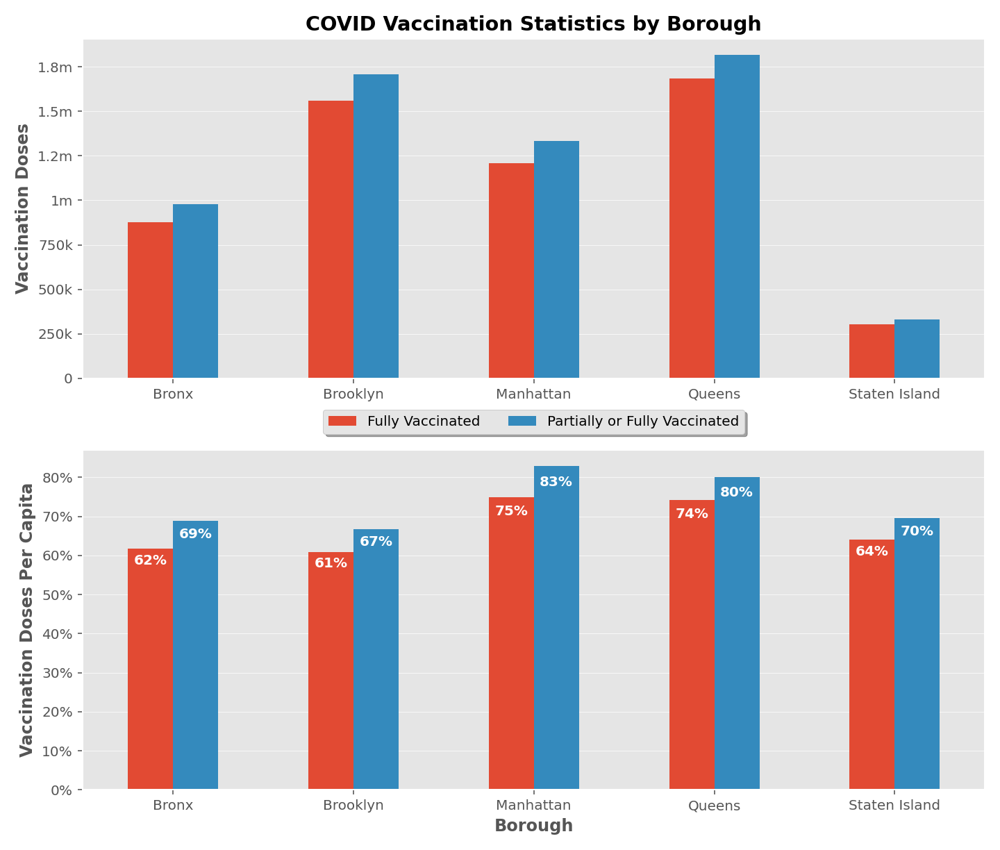
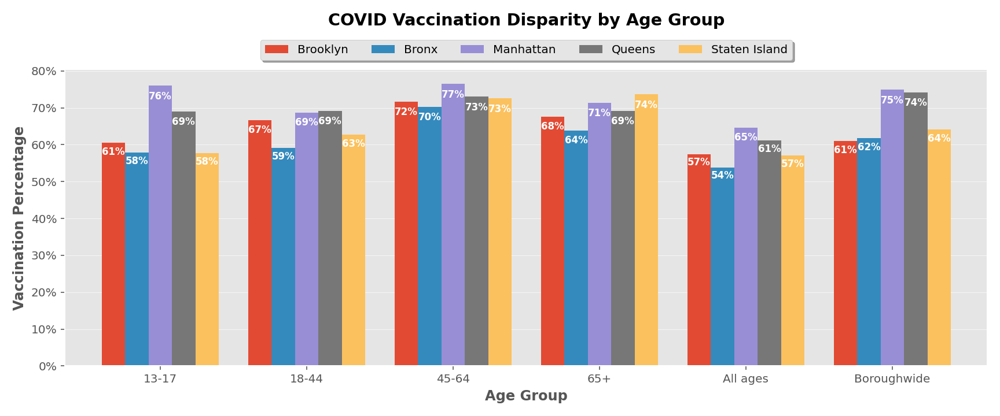
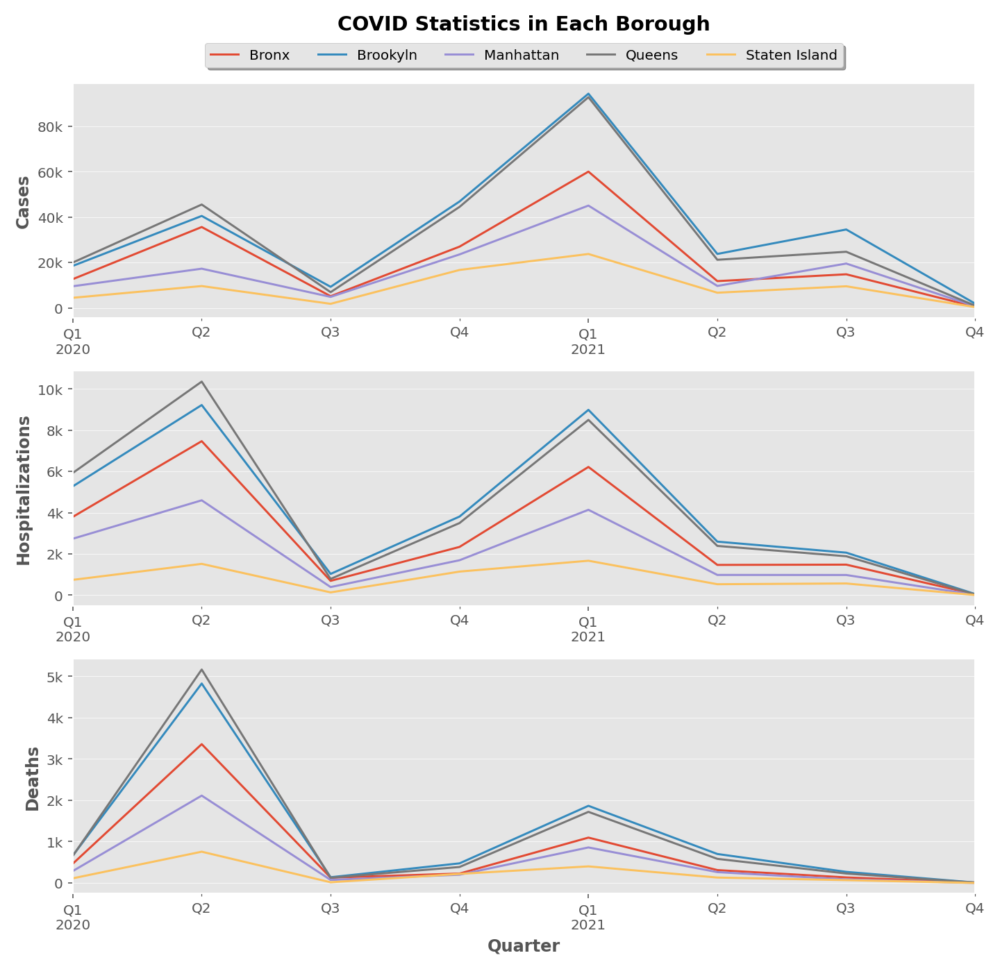
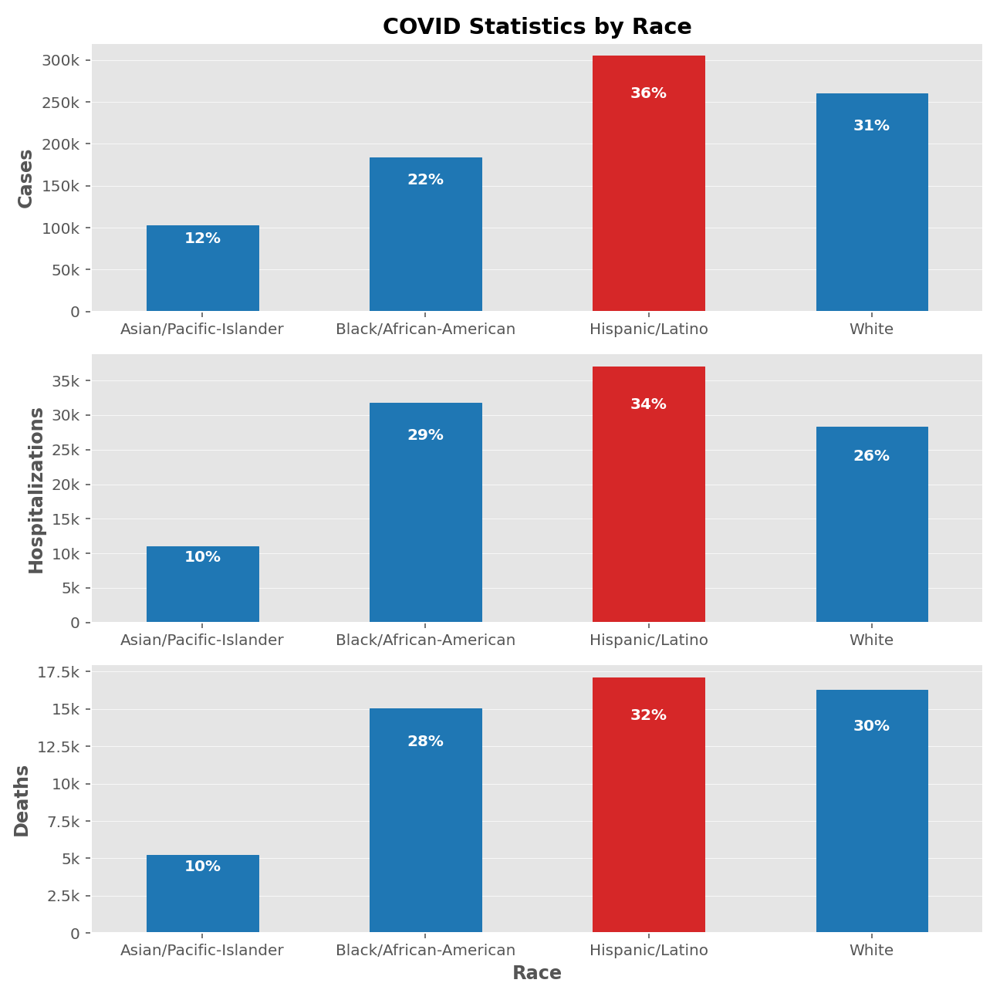
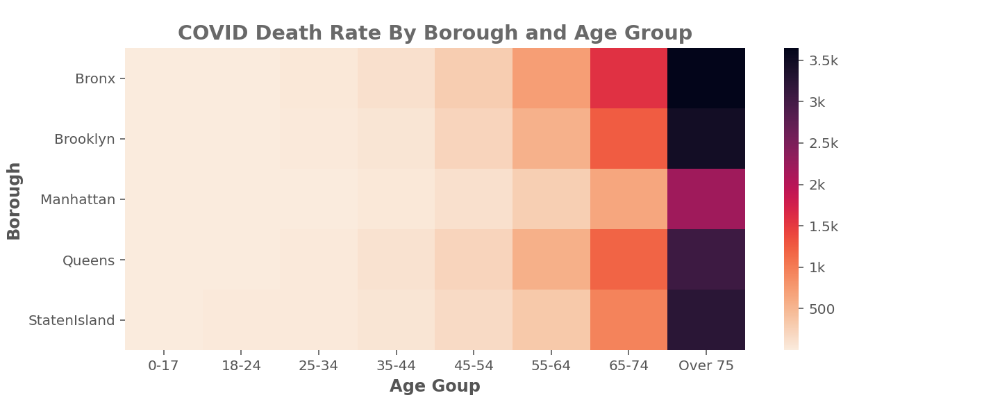
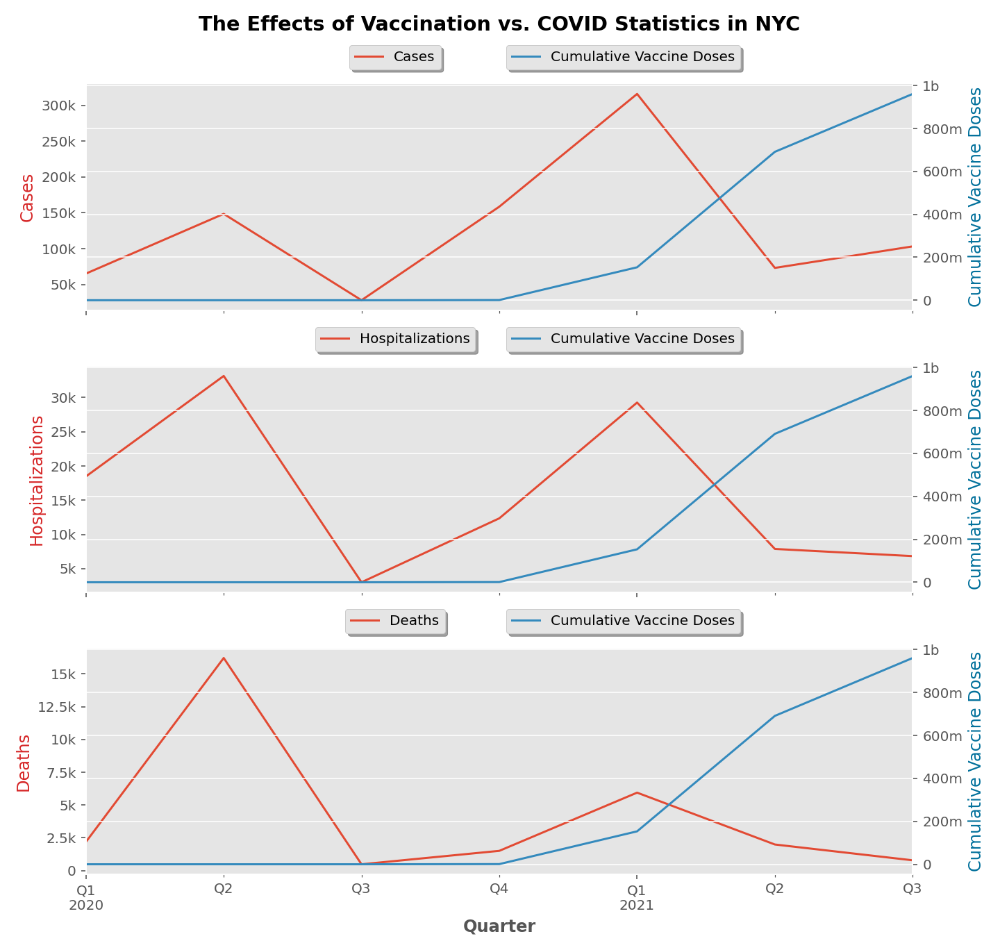
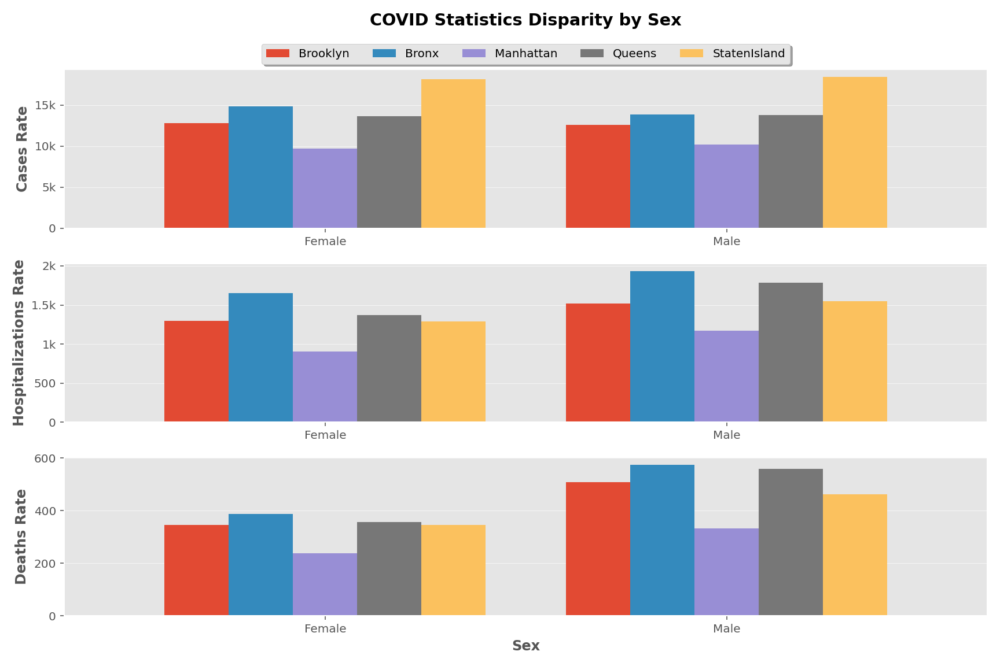
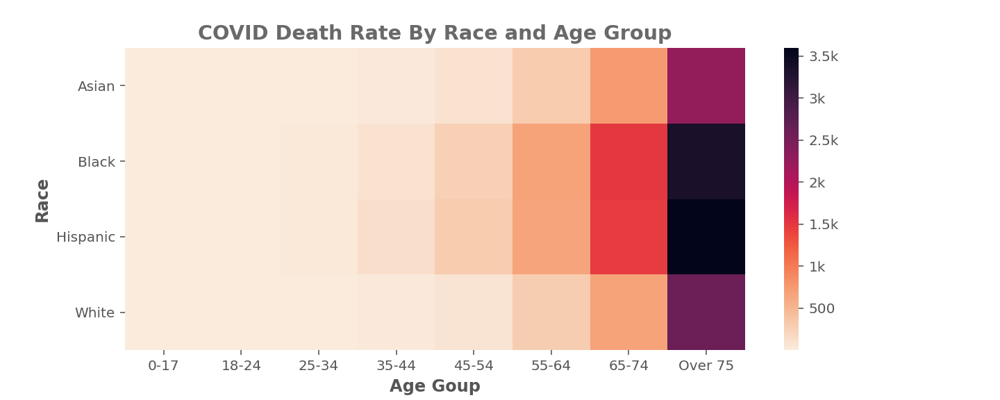

In [88]:
# Organize servable panels for heroku server
pn.Column(pn.Row(title, image), name, pn.Spacer(height=10), tabs).servable(title="COVID Watch NYC")


In [89]:
# Organize servable panels for local server
pn.Column(pn.Row(title, image), name, pn.Spacer(height=10), tabs).show(title="COVID Watch NYC")


Launching server at http://localhost:57459
